# SMI Data Reduction for Grazing-Incidence Angle-of-Incidence Scans

### Setup
##### Package imports

In [1]:
import os
# os.environ["OMP_NUM_THREADS"] = "1" # Prevent numpy from using multiple threads when using emcee multiprocessing.
# These packages should all be installed if the procedure was followed
%matplotlib widget
import matplotlib, matplotlib.pyplot as plt, matplotlib.colors as mplc, matplotlib.cm as cm
matplotlib.interactive(True)
plt.ion()
from smi_analysis import SMI_beamline
import numpy as np, numpy.typing as npt
import pandas as pd
import fabio
import logging
import scipy.constants as const
import time
import corner
from typing import Literal, Callable
import emcee
import tqdm, tqdm.notebook # For progress bars
from scipy.optimize import curve_fit
import warnings

# Setup options
fabio.TiffIO.logger.setLevel(logging.ERROR)
pd.set_option("display.width", 1000) #display large filenames
pd.set_option('max_colwidth', None)

ERROR:pygix.transform:Unable to import pyFAI.ocl_azim_csr: cannot import name 'ocl_azim_csr' from 'pyFAI' (d:\Github\smi-analysis\venv\Lib\site-packages\pyFAI\__init__.py)
ERROR:pygix.transform:Unable to import pyFAI.ocl_azim_lut for: cannot import name 'ocl_azim_lut' from 'pyFAI' (d:\Github\smi-analysis\venv\Lib\site-packages\pyFAI\__init__.py)
ERROR:pygix.transform:Unable to import pyFAI.ocl_sort for: cannot import name 'ocl_sort' from 'pyFAI' (d:\Github\smi-analysis\venv\Lib\site-packages\pyFAI\__init__.py)


In [2]:
# Define some useful functions
en2wav = lambda en: const.h * const.c / (const.e * en)
"""Function to convert energy (eV) to wavelength"""
en2wav(2.45e3)

5.060579527885725e-10

##### Experimental configuration

In [3]:
geometry: Literal['Transmission'] | Literal['Reflection'] = 'Reflection'
"""The measurement geometry"""
energy: float = 2.45e3
"""The energy (keV) at which the scan is performed"""
wavelength: float = en2wav(energy)
"""The wavelength corresponding to `energy`."""
beamstop_type: Literal["pindiode"] | Literal['rod'] = 'pindiode'
"""The beamstop type"""
incident_angle = np.deg2rad(0)
"""The default incident angle (varies)"""

#WAXS
detector_waxs: Literal['Pilatus900kw'] | Literal['Pilatus1m'] = 'Pilatus900kw'
"""Type of WAXS/SAXS detector"""
sdd_waxs: float | int = 280 # In mm
"""Sample to detector distance in millimeters"""
center_waxs: tuple[int|float, int|float] = [97, 1255.9]
"""Coordinates of the beam centre at 0 degrees, for the middle detector strip"""
bs_pos_waxs: list[tuple[int, int]] = [[(195+17) + 98, 1187]] #, [0, 0], [0, 0]
"""The position of the center of the beam stop for each detector angle; [0,0] implies not measured. 
This coordinate is relative to the stitch of the 3 detector strips."""
detector_angles: list[int | float] | npt.NDArray[np.float64 | np.int_] = np.deg2rad(np.array([0]) - 0.06) #0.06 is the correction for the WAXS 0 deg detector position
"""The angles of the detector in radians. 
May need to include corrections (-0.06 degs at 0, -0.36 at 20 deg) for position offsets."""


display(pd.DataFrame([
    ("Geometry", geometry),
    ("Energy (keV)", energy),
    ("Wavelength (nm)", wavelength * 1e9),
    ("Sample to Detector Distance (mm)", sdd_waxs),
    ("Beamstop Type", beamstop_type),
    ("Incident Angle (deg)", np.rad2deg(incident_angle)),
    ("Detector Type", detector_waxs),
    ("Center Coords", center_waxs),
    ("Beamstop Coords", bs_pos_waxs),
    ("Detector Angles", detector_angles)
], columns=["Parameter", "Value"]))

#Test the configuration can be loaded!
SMI_waxs = SMI_beamline.SMI_geometry(geometry = geometry,
                                     wav = wavelength,
                                     sdd = sdd_waxs,
                                     alphai = incident_angle,
                                     detector = detector_waxs,
                                     center = center_waxs,
                                     bs_pos = bs_pos_waxs,
                                     bs_kind = beamstop_type,
                                     det_angles=detector_angles)


,Parameter,Value
0,Geometry,Reflection
1,Energy (keV),2450.0
2,Wavelength (nm),0.506058
3,Sample to Detector Distance (mm),280
4,Beamstop Type,pindiode
5,Incident Angle (deg),0.0
6,Detector Type,Pilatus900kw
7,Center Coords,"[97, 1255.9]"
8,Beamstop Coords,"[[310, 1187]]"
9,Detector Angles,[-0.0010471975511965976]


### Flatfield Data
Data to normalise the detector pixels and remove background.

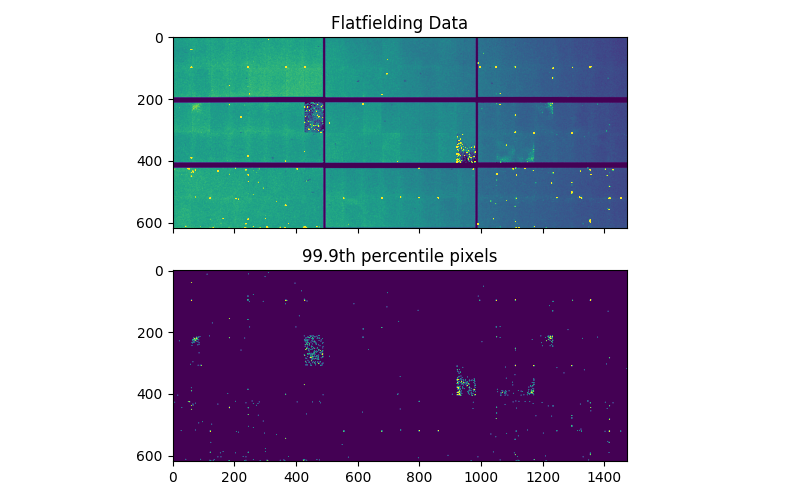

In [4]:
# Past beamline data for flat fielding (normalizing default pixel intensities)
# Note this is done at 2478eV, not all energies.

# # 2024 Cycle 2 Flatfielding
# CYCLE_FLAT = '2024_3'
# PROPOSAL_FLAT= '314483-Freychet-Flatfielding'
# FLAT_FILE = 'GF_flatfield_Sedge_2450uhighg1600_WZY11_wa30deg_2478eV_20s_id701601_000000_WAXS.tif'

# 2024 Cycle 3 Flatfielding
PROPOSAL_FLAT= '314483_Freychet_08'
FLAT_FILE = 'GF_GF_flatfield_Sedge_2450uhighg1600_Y2_06_2477.00eV_wa20deg_id807229_000000_WAXS.tif'

# Compile and load the flatfield path
FLAT_DIR_PATH = f'D:/Datasets/2024-09 SMI/{PROPOSAL_FLAT}/900KW/'
flatfield: npt.NDArray = np.rot90(fabio.open(os.path.join(FLAT_DIR_PATH, FLAT_FILE)).data, 1)

fig,ax = plt.subplots(2,1, sharex=True, sharey=True, figsize=(8,5))
p = 99.9
percentile = np.percentile(flatfield, p) #99.9th percentile
ax[0].imshow(np.rot90(flatfield, 3), vmin=0, vmax=percentile, interpolation=None)
ax[0].set_title("Flatfielding Data")

erronous =  (flatfield > percentile) * 1.0
ax[1].imshow(np.rot90(erronous,3), vmin=0, vmax=np.max(erronous)/5, interpolation=None)
ax[1].set_title(f"{p}th percentile pixels")
fig.tight_layout()
# plt.close()

### Extra functions for SMI Beamline Masking

##### Detector Masking

In [5]:
def apply_detector_mask_to_array(
    mask: npt.NDArray = np.zeros((1475, 195), dtype=bool)
) -> npt.NDArray[np.bool]:
    """Sets an array mask for bad pixels; should only be applied to the middle column array"""
    mask[1254:1256, 47] = True
    mask[979:1050, 0:100] = True
    mask[967, 67] = True
    mask[490:555, 100:] = True
    mask[1231:1233, 174] = True
    mask[1414: 1416, 179] = True
    mask[858:860, 5] = True
    mask[414, 6] = True
    mask[394, 138] = True
    mask[364:366, 41] = True
    mask[364:366, 96] = True
    mask[304:306, 96:98] =  True
    mask[988, 188:194] = True
    mask[:, 1] = True
    mask[473, 20] = True
    mask[98, 5] = True
    mask[141, 111] = True
    mask[240:300, 0:50] = True
    mask[300:425, 125:] = True
    mask[181:183, 97:99] = True
    mask[553:555, 99:100] = True
    return mask

def apply_boundary_mask_to_array(
    mask: npt.NDArray = np.zeros((1475, 195), dtype=bool)
) -> npt.NDArray[np.bool]:
    """Sets an array mask for the boundary pixels; should only be applied to the middle column array"""
    mask[0, :] = True
    mask[-1, :] = True
    mask[:, 0] = True
    mask[:, -1] = True
    return mask

def apply_detector_mask(geom: SMI_beamline.SMI_geometry) -> None:
    """Applies a pre-defined mask for the bad pixels in the SMI beamline"""
    for i, mask in enumerate(geom.masks):
        # Dead pixels in the 2nd detector strip.
        if i%3 == 1: # For multiple WAXS images, always masks the 2nd strip.
            apply_detector_mask_to_array(mask)
        # Add a mask on the boundary
        apply_boundary_mask_to_array(mask)
    return


##### Flatield Masking

In [6]:
FLATFIELD_PERCENTILE = 99.5
"""The percentile of the flatfield data to mask."""
SAMPLE_PERCENTILE = 99.99
"""The percentile of the real data to mask."""

# For flatfielding, ignore/mask reigons between detector pixels.
FLATFIELD_SLICES = [slice(0, 195),  # Ign. flatfield above first frame
                    slice(211, 406),# Ign. flatfield outside middle  
                    slice(-195, None)] # Ign. flatfield below first frame
            
def flatfield_mask(flatfield: npt.NDArray = flatfield, 
                   percentile: float = FLATFIELD_PERCENTILE, 
                   min: float | int = 0) -> npt.NDArray[np.bool]:
        """
        Returns a mask of flatfield data as a boolean numpy array.
        
        Masks pixels above the `percentile` (by default 99.9)
        and values less than `min` (by default 1).
        """
        # Calculate the 99.9th percentile of the total flatfield data
        p = np.percentile(flatfield, percentile) #99.9th percentile
        erronous =  flatfield > p
        # Also mask negative and zero pixels
        negative = flatfield < min
        # Return the overlap of the erronous and negative masks.
        return erronous | negative

def apply_flatfield(geom: SMI_beamline.SMI_geometry, 
                    flatfield: npt.NDArray, 
                    flat_percentile: float | int = FLATFIELD_PERCENTILE,
                    img_percentile: float | int = SAMPLE_PERCENTILE,
                    min : float | int = 1) -> None:
    """Applies a pre-defined flatfield mask and normalisation for the SMI beamline object"""
    flatmask = flatfield_mask(flatfield=flatfield, percentile=flat_percentile, min = min)
    for i, (mask, img) in enumerate(zip(geom.masks, geom.imgs)):
        fmask_i = flatmask[:, FLATFIELD_SLICES[i % 3]]
        # Apply the masking values
        masking_values = np.where(fmask_i == True)
        mask[masking_values] = True
        # Apply the normalisation 
        flat = flatfield[:, FLATFIELD_SLICES[i%3]] # Get flatfield panel
        flat[flat < 0] = 10000 # avoid negative values - note these are already masked
        # Multiply img by max of flatfield, then divide by flatfield to keep integer precision of img.
        temp = ((img * np.max(flatfield[:, FLATFIELD_SLICES[i%3]] * ~mask))
                / (flat * ~mask +1)) * ~mask # Avoid divide by zero, and zero mask values.
        # This line creates a runtime error due to casting... img is int32, flat is float64
        img[:] = temp.astype(np.int32)
    
        # Repeat mask for very large values erronously normalised
        mask2 = flatfield_mask(flatfield=img, percentile=img_percentile, min = 0) # only consider positive values.
        masking_values2 = np.where(mask2 == True)
        mask[masking_values2] = True
    return


##### Show the stages of Flatfield masking

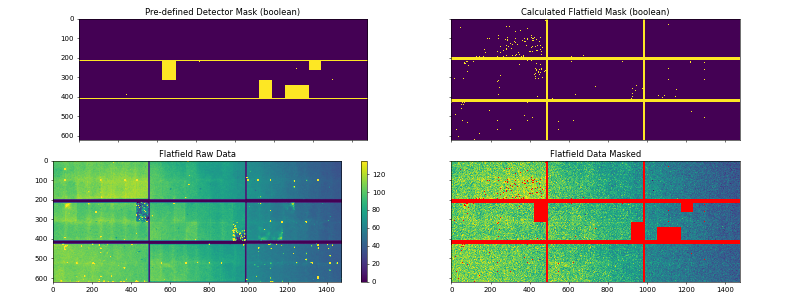

In [7]:
fig,ax = plt.subplots(2,2, figsize=(16,6), dpi=50, sharex=True, sharey=True)

# Detector image is (619, 1475) #619 is 195 * 3 + 2 * 17
# Show the detector masking
grid = np.zeros((195, 1475), dtype=bool)


det_mask = np.c_[apply_boundary_mask_to_array(grid.copy().T),
                 np.zeros((17, 1475), dtype=bool).T,
                 apply_detector_mask_to_array(apply_boundary_mask_to_array(grid.copy().T)), # 195 pixels
                 np.zeros((17, 1475), dtype=bool).T,
                apply_boundary_mask_to_array(grid.copy().T)]
    

det_im = ax[0][0].imshow(np.rot90(det_mask,3), interpolation='nearest') # required to prevent interpolation
ax[0][0].set_title("Pre-defined Detector Mask (boolean)")

# Show the flatfield masking
ff_masked = flatfield_mask(flatfield)
ff_masked_im = ax[0][1].imshow(np.rot90(ff_masked,3), interpolation='nearest') # required to prevent interpolation
ax[0][1].set_title("Calculated Flatfield Mask (boolean)")

# Show the flatfield image
ff_im = ax[1][0].imshow(np.rot90(flatfield,3), vmin = 0, vmax = np.percentile(flatfield, FLATFIELD_PERCENTILE))
plt.colorbar(ff_im)
ax[1][0].set_title("Flatfield Raw Data")

# Show the masks on the flatfield image
joined_mask = ff_masked | det_mask
cmap = mplc.LinearSegmentedColormap.from_list("Mask", [(256,0,0,0),(256,0,0,256)], N=2)
ff_im_masked = ax[1][1].imshow(np.rot90(flatfield,3), interpolation='nearest',
                               vmin = 0, vmax = np.percentile(flatfield, FLATFIELD_PERCENTILE))
ax[1][1].imshow(np.rot90(joined_mask,3), cmap=cmap, interpolation='nearest')
ax[1][1].set_title("Flatfield Data Masked")

fig.tight_layout()
# plt.close()

### Data Import

##### Locate the files on your computer and define the output directory

In [8]:
CYCLE: str = '2024_3' #YYYY_[1-3]
PROPOSAL_ID = '316022_McNeil_04' #PPPPPP_[Name]_[#]
## ----------- Path to the raw data -----------

# RAW_PATH = f'D:/Datasets/2024-09 SMI/{CYCLE}/{PROPOSAL_ID}/900KW/'
RAW_DIR = f'D:/Datasets/2024-09 SMI/{PROPOSAL_ID}/900KW/'
display(pd.DataFrame(os.listdir(RAW_DIR), columns=["Filename"])) #use tail or head to display a subset

## ----------- Create/select the results directory -----------
RESULT_DIR = f'D:/Datasets/2024-09 SMI/{PROPOSAL_ID}/angle_scan_results/'
created = False
for i in range(len(RESULT_DIR.split("/"))):
    if not os.path.isdir("/".join(RESULT_DIR.split("/")[:i+1])) and not (i==0 and RESULT_DIR[0]=="/"):
        os.mkdir("/".join(RESULT_DIR.split("/")[:i+1]))
        created = True
if not created:
    print("Results path exists!")

,Filename
0,CM_A1_01_a_2445.00eV_ai0.80_wa0_bpm118.055_id779746_000000_WAXS.tif
1,CM_A1_01_a_2445.00eV_ai0.80_wa20_bpm118.472_id779809_000000_WAXS.tif
2,CM_A1_01_a_2450.00eV_ai0.80_wa0_bpm119.200_id779747_000000_WAXS.tif
3,CM_A1_01_a_2450.00eV_ai0.80_wa20_bpm119.501_id779810_000000_WAXS.tif
4,CM_A1_01_a_2455.00eV_ai0.80_wa0_bpm120.016_id779748_000000_WAXS.tif
...,...
2063,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.500_wa0_bpm119.446_id781575_000000_WAXS.tif
2064,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.600_wa0_bpm119.430_id781576_000000_WAXS.tif
2065,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.700_wa0_bpm119.493_id781577_000000_WAXS.tif
2066,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif


Results path exists!


##### Organise files into sample names and data for each detector angle

In [9]:
filename_flags: list[str] = ['wide', '2450', "A1"]
"""The strings you want included in the files processed."""

# Find all samples
samples: list[str] = []
"""String names of the unique samples matching patterns in `filename_flags`"""
for file in sorted(os.listdir(RAW_DIR)):
     # Define the flags for the files you want to process, by filtering the filename.
     if all([flag in file for flag in filename_flags]) and "A1_01" not in file:
        # Find the angle of incidence:
        idx = file.find('_ai')
        sample_substring = file[:idx+1]
        # If sample substring not in list of samples, add it!
        if sample_substring not in samples:
            samples.append(sample_substring)

# Find all TIF image measurements
datasets: list[list[str]] = [[] for _ in samples]
count = 0
"""A list for each sample, corresponding to the raw data filenames. 
Each sample list will be an index of anles of incidence."""
for i, sample in enumerate(samples):
        for j, file in enumerate(sorted(os.listdir(RAW_DIR))):
                if all([flag in file for flag in filename_flags + [sample, '.tif']]):
                        datasets[i].append(file)

# Display the number of files for each sample:
display(
      pd.DataFrame([
            (sample, len(datasets[i]))
            for i, sample in enumerate(samples)
      ], columns=["Sample Name", "Number of Files"])
)

,Sample Name,Number of Files
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_,139
1,CM_wideincidentanglescan_A1_03_a_2450.00eV_,139
2,CM_wideincidentanglescan_A1_04_a_2450.00eV_,139


# Reduction
### Run the first sample to check everything is working and define the Q fit ranges

##### First check sample image exists and looks reasonable!

CM_wideincidentanglescan_A1_02_a_2450.00eV_ | ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif


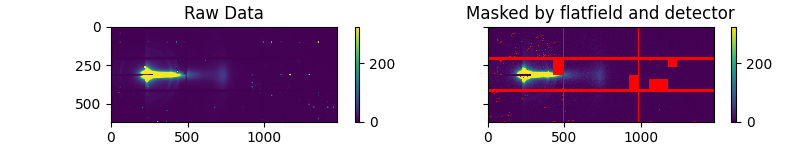

CM_wideincidentanglescan_A1_02_a_2450.00eV_ | ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif


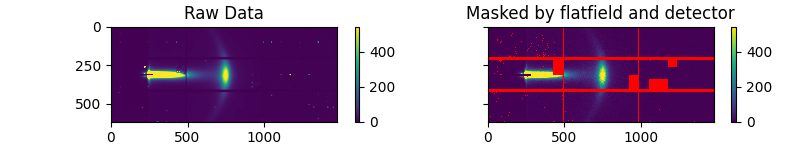

CM_wideincidentanglescan_A1_02_a_2450.00eV_ | ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif


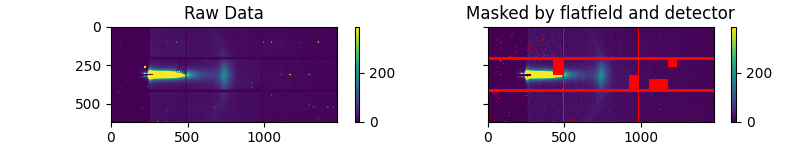

CM_wideincidentanglescan_A1_02_a_2450.00eV_ | ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif


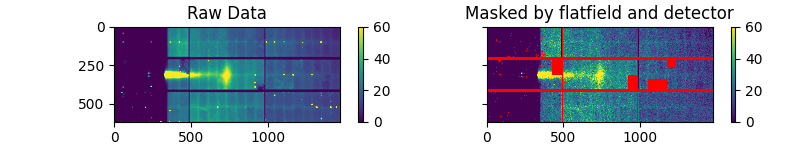

------------------------------
CM_wideincidentanglescan_A1_03_a_2450.00eV_ | ai0.200_wa0_bpm119.176_id780788_000000_WAXS.tif


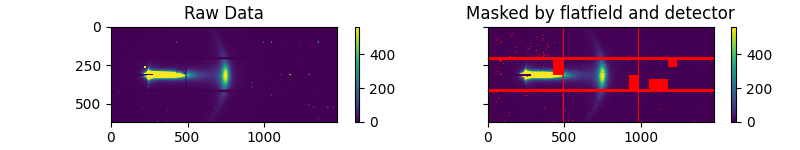

CM_wideincidentanglescan_A1_03_a_2450.00eV_ | ai0.541_wa0_bpm119.612_id780828_000000_WAXS.tif


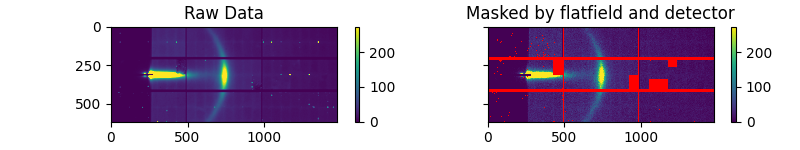

CM_wideincidentanglescan_A1_03_a_2450.00eV_ | ai0.661_wa0_bpm119.599_id780868_000000_WAXS.tif


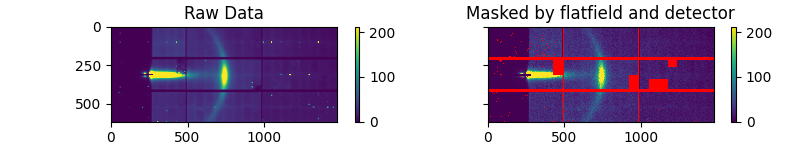

CM_wideincidentanglescan_A1_03_a_2450.00eV_ | ai3.800_wa0_bpm119.525_id780925_000000_WAXS.tif


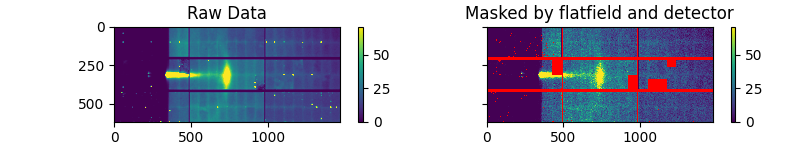

------------------------------
CM_wideincidentanglescan_A1_04_a_2450.00eV_ | ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif


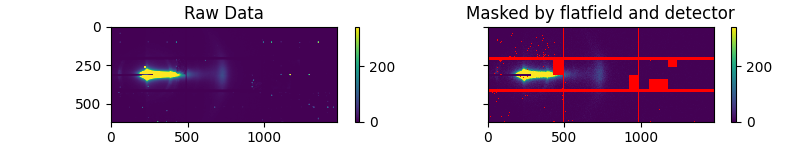

CM_wideincidentanglescan_A1_04_a_2450.00eV_ | ai0.541_wa0_bpm119.633_id781481_000000_WAXS.tif


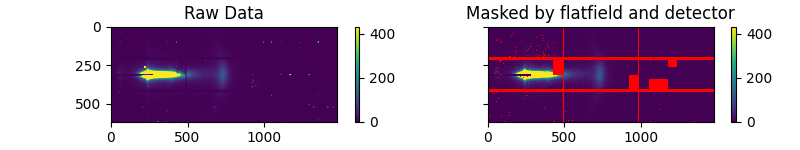

CM_wideincidentanglescan_A1_04_a_2450.00eV_ | ai0.661_wa0_bpm119.755_id781521_000000_WAXS.tif


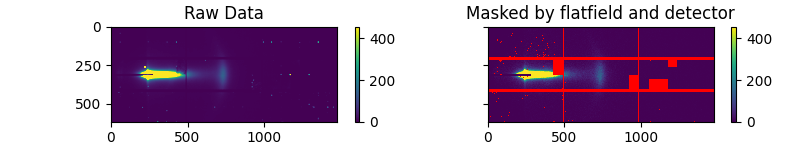

CM_wideincidentanglescan_A1_04_a_2450.00eV_ | ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif


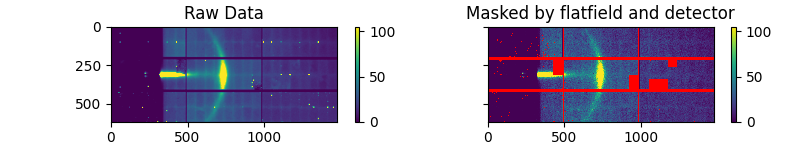

------------------------------


In [10]:
test_files: list[int] = [0, 40, 80, -2]
"""The index of each sample's test file"""

for i, sample in enumerate(samples):
    for test_file in test_files:
        print(sample, "|", datasets[i][test_file].replace(sample, ""))
        fig,ax = plt.subplots(1,2, figsize=(8,1.5), sharex=True, sharey=True)
        fname = datasets[i][test_file]
        # fig.suptitle(sample)
        # Use 
        img=fabio.open(os.path.join(RAW_DIR, fname)).data
        mappable = ax[0].imshow(img, vmin=0, vmax=np.percentile(img,99))
        ax[0].set_title("Raw Data")
        plt.colorbar(mappable)
        
        # Show the masks on the flatfield image
        cmap = mplc.LinearSegmentedColormap.from_list("Mask", [(256,0,0,0),(256,0,0,256)], N=2)
        ff_im_masked = ax[1].imshow(img, interpolation='nearest',
                                vmin = 0, vmax = np.percentile(img, 99))
        ax[1].imshow(np.rot90(joined_mask,3), cmap=cmap, interpolation='nearest')
        ax[1].set_title("Masked by flatfield and detector")
        plt.colorbar(ff_im_masked)
        
        fig.tight_layout()
        plt.show()
    print("------------------------------")

##### Import data via SMI beamline and observe the application of internal masking and flatfielding.

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif,2450.0,0.2


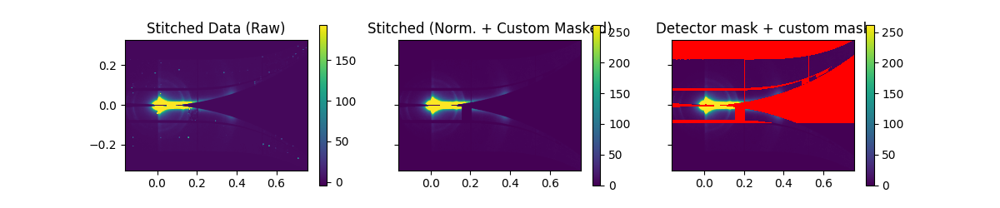

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif,2450.0,0.541


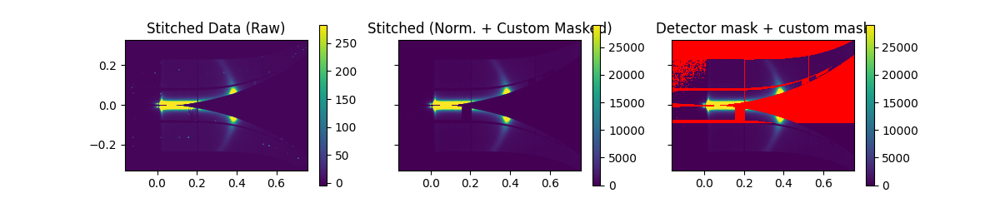

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif,2450.0,0.661


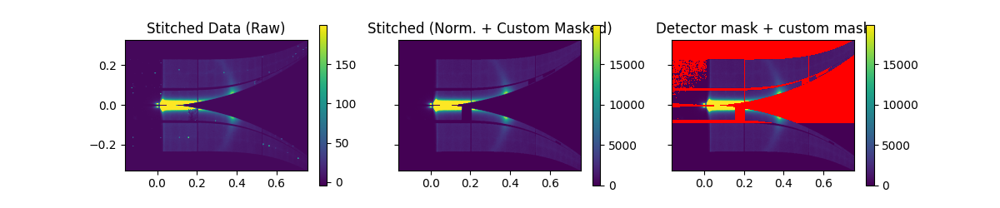

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif,2450.0,3.8


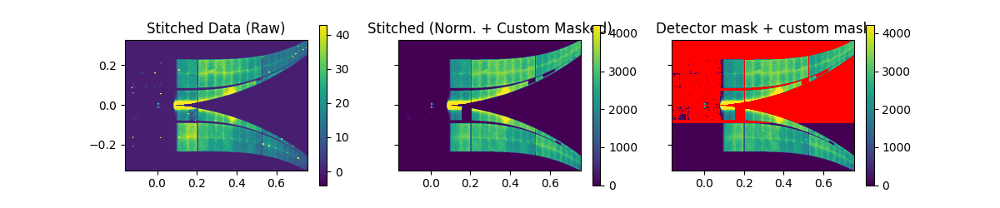

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.200_wa0_bpm119.176_id780788_000000_WAXS.tif,2450.0,0.2


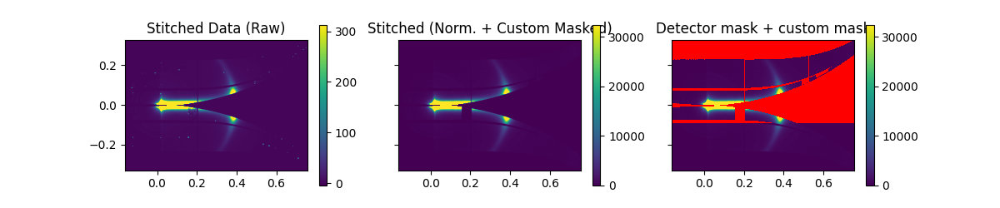

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.541_wa0_bpm119.612_id780828_000000_WAXS.tif,2450.0,0.541


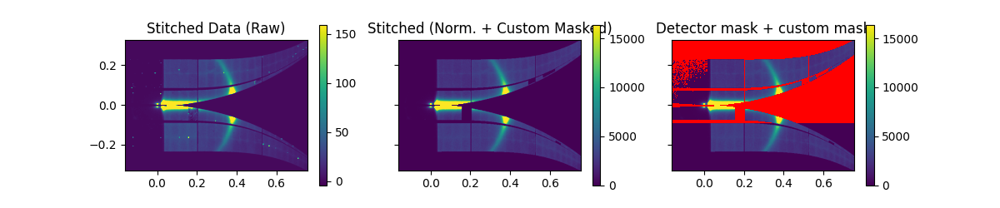

C:\Users\mgebert\AppData\Local\Temp\ipykernel_9152\1813384943.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax = plt.subplots(1,3, figsize=(12,2.5), sharex=True, sharey=True)


,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.661_wa0_bpm119.599_id780868_000000_WAXS.tif,2450.0,0.661


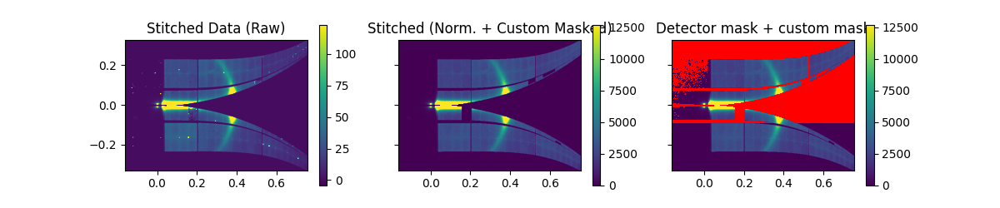

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai3.800_wa0_bpm119.525_id780925_000000_WAXS.tif,2450.0,3.8


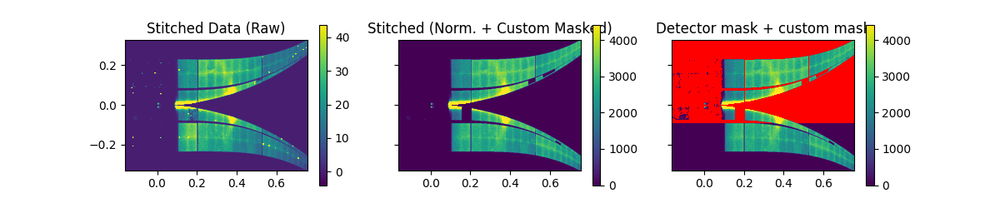

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif,2450.0,0.2


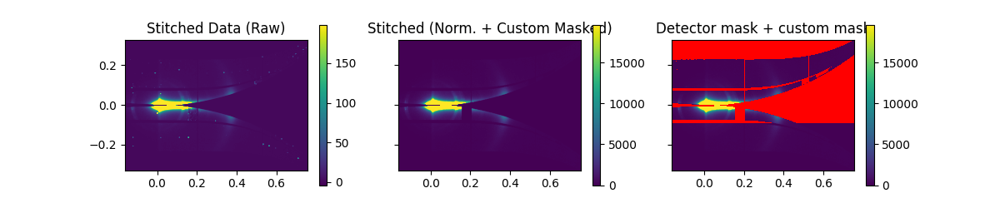

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.541_wa0_bpm119.633_id781481_000000_WAXS.tif,2450.0,0.541


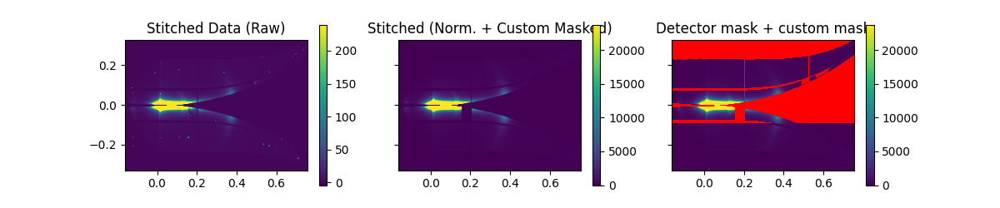

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.661_wa0_bpm119.755_id781521_000000_WAXS.tif,2450.0,0.661


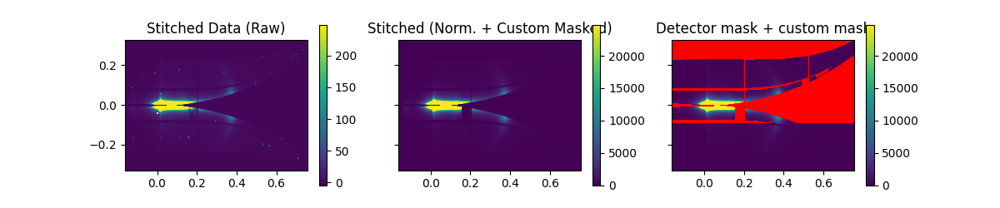

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif,2450.0,3.8


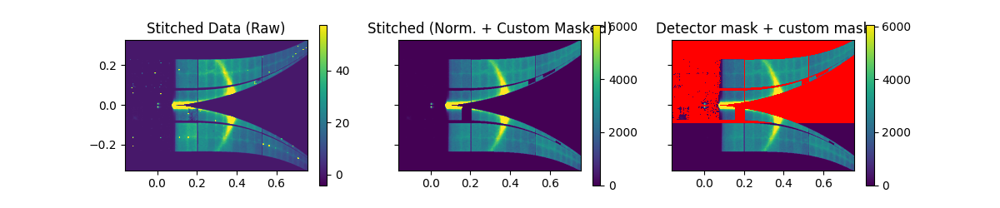

In [11]:
## Note: Tried digging into SMI_beamline > SMI_geometry > stitching_data > stitch.stitching, to understand how the mask is stitched. 
## Too difficult to follow, for some reason mask is not really applied well in the first sector of the detector.

for i, sample in enumerate(samples):
    for test_file in test_files:
        # Setup a figure and open the file
        fig,ax = plt.subplots(1,3, figsize=(12,2.5), sharex=True, sharey=True)
        fname = datasets[i][test_file]
        
        # Collect the metadata
        en_idx = fname.find('eV_')
        en = float(fname[en_idx-7:en_idx])
        ai_idx = fname.find("_ai")
        ai = float(fname[ai_idx+3:ai_idx+8])
        display(pd.DataFrame([
                (fname, en, ai)
                ], columns=["Filename", "Energy (eV)", "Incident Angle (deg)"]))
        
        # Update the geometry
        SMI_waxs.alphai = np.deg2rad(ai)
        SMI_waxs.wav = en2wav(en)
        
        # Reset the masks
        for mask in SMI_waxs.masks:
            mask[:,:] = False
        
        # Plot the unmodified data
        SMI_waxs.open_data(RAW_DIR, [fname])
        SMI_waxs.stitching_data(interp_factor=2, flag_scale=False)
        # mp = ax[0].imshow(SMI_waxs.img_st,
        #         extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]], 
        mp = ax[0].imshow(np.rot90(SMI_waxs.img_st.T, 2),
                extent=[SMI_waxs.qz[0], SMI_waxs.qz[-1], SMI_waxs.qp[0], SMI_waxs.qp[-1]], 
                # vmin=0,
                vmax=np.percentile(SMI_waxs.img_st, 99)
        )
        plt.colorbar(mp)
        ax[0].set_title("Stitched Data (Raw)")
        
        # Plot the flatfield / masked normalized data
        SMI_waxs.open_data(RAW_DIR, [fname])
        apply_detector_mask(SMI_waxs)
        apply_flatfield(SMI_waxs, flatfield, flat_percentile=FLATFIELD_PERCENTILE, img_percentile=SAMPLE_PERCENTILE)
        apply_detector_mask(SMI_waxs)
        SMI_waxs.stitching_data(interp_factor=1, flag_scale=False)
        # mp = ax[1].imshow(SMI_waxs.img_st,
                # extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]], 
        mp = ax[1].imshow(np.rot90(SMI_waxs.img_st.T,2),
                extent=[SMI_waxs.qz[0], SMI_waxs.qz[-1], SMI_waxs.qp[0], SMI_waxs.qp[-1]], 
                # vmin=np.percentile(SMI_waxs.img_st, 1.0), 
                vmax=np.percentile(SMI_waxs.img_st, 99.0)
        )
        plt.colorbar(mp)
        ax[1].set_title("Stitched (Norm. + Custom Masked)")
        
        # Show the total mask over the image
        cmap = mplc.LinearSegmentedColormap.from_list("Mask", [(256,0,0,0),(256,0,0,256)], N=2)
        mp = ax[2].imshow(np.rot90(SMI_waxs.img_st.T,2),
                extent=[SMI_waxs.qz[0], SMI_waxs.qz[-1], SMI_waxs.qp[0], SMI_waxs.qp[-1]], 
                # vmin=np.percentile(SMI_waxs.img_st, 1.0), 
                vmax=np.percentile(SMI_waxs.img_st, 99.0)
        )
        ax[2].imshow(~np.rot90(SMI_waxs.mask_st != 0, 1),
                extent=[SMI_waxs.qz[0], SMI_waxs.qz[-1], SMI_waxs.qp[0], SMI_waxs.qp[-1]],
                cmap=cmap
        )
        plt.colorbar(mp)
        ax[2].set_title("Detector mask + custom mask")
        plt.show()

##### Generate a ROI to check the beam-centre 
###### Also check that the beamcentre is correct by symmetry (unless sample has anisotropic behavour)

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif,2450.0,0.2


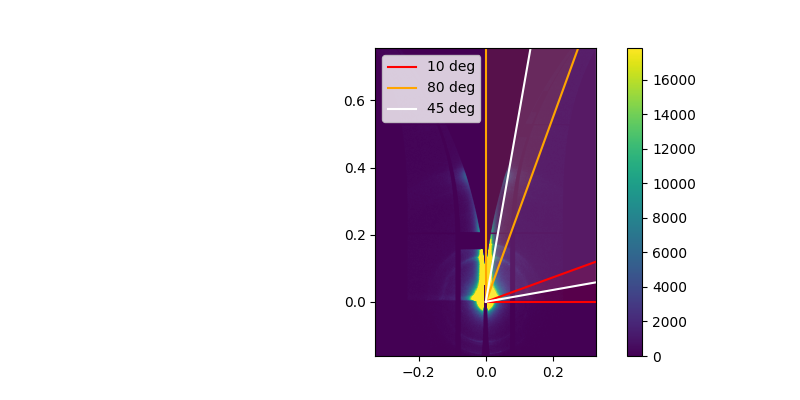

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif,2450.0,0.541


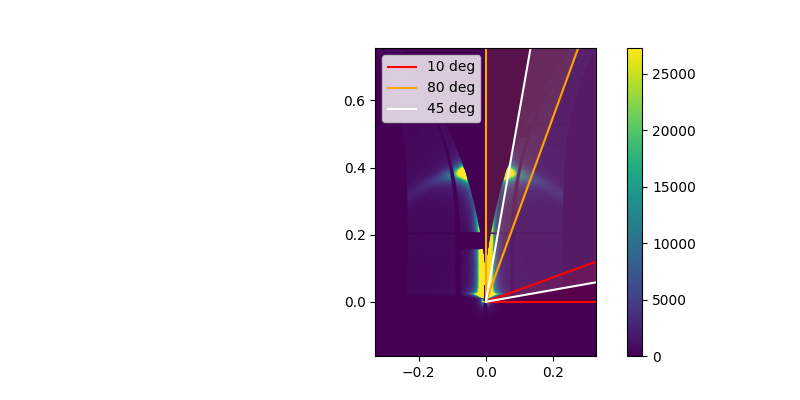

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif,2450.0,0.661


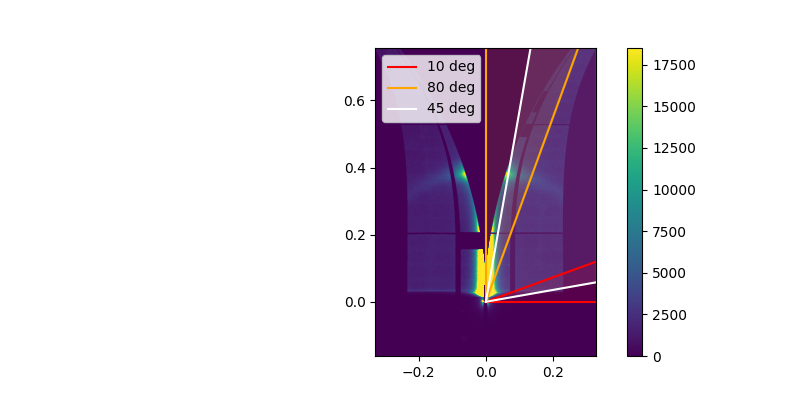

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif,2450.0,3.8


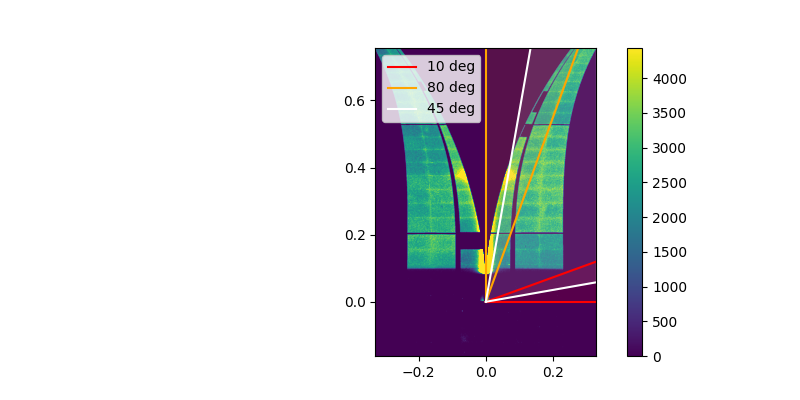

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.200_wa0_bpm119.176_id780788_000000_WAXS.tif,2450.0,0.2


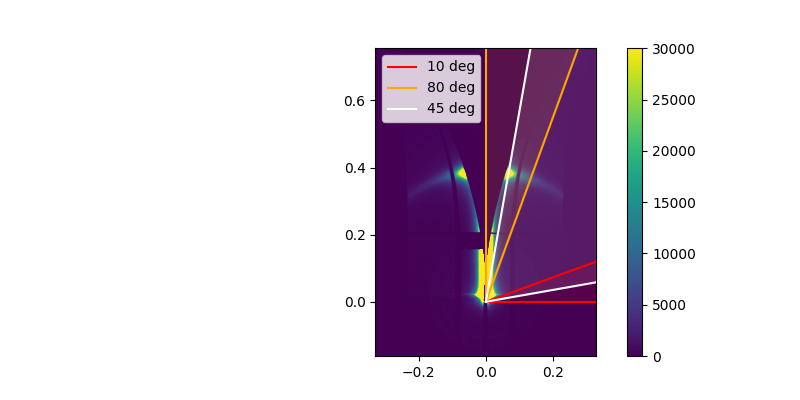

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.541_wa0_bpm119.612_id780828_000000_WAXS.tif,2450.0,0.541


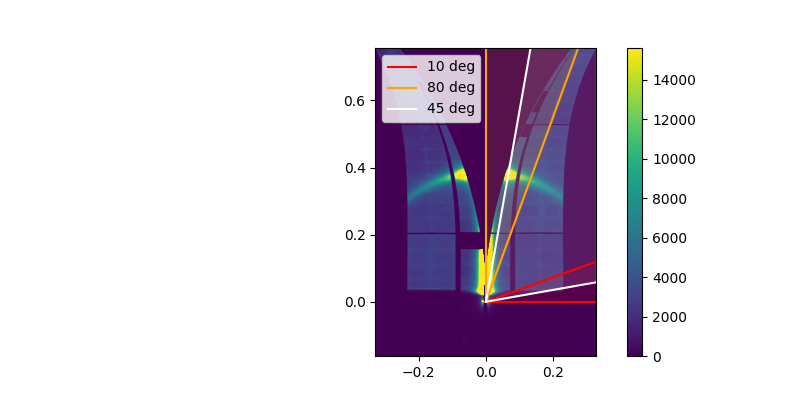

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.661_wa0_bpm119.599_id780868_000000_WAXS.tif,2450.0,0.661


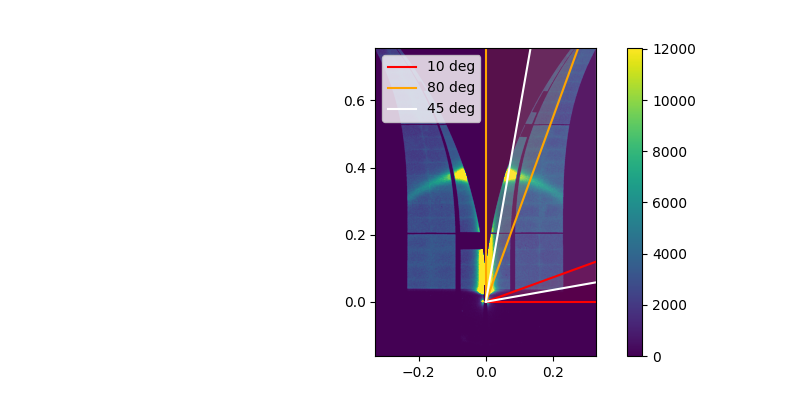

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai3.800_wa0_bpm119.525_id780925_000000_WAXS.tif,2450.0,3.8


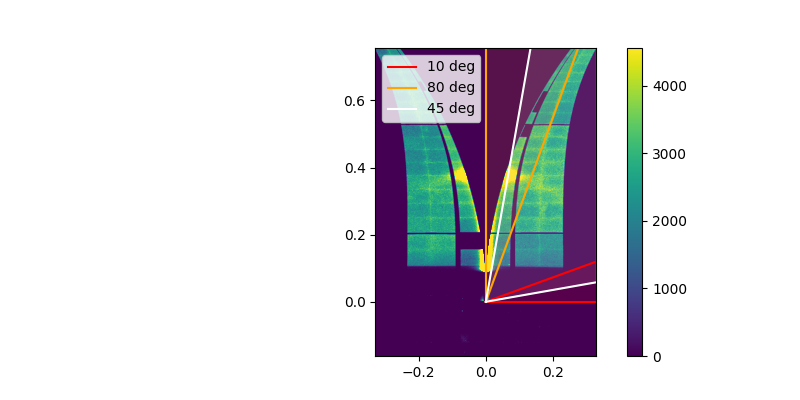

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif,2450.0,0.2


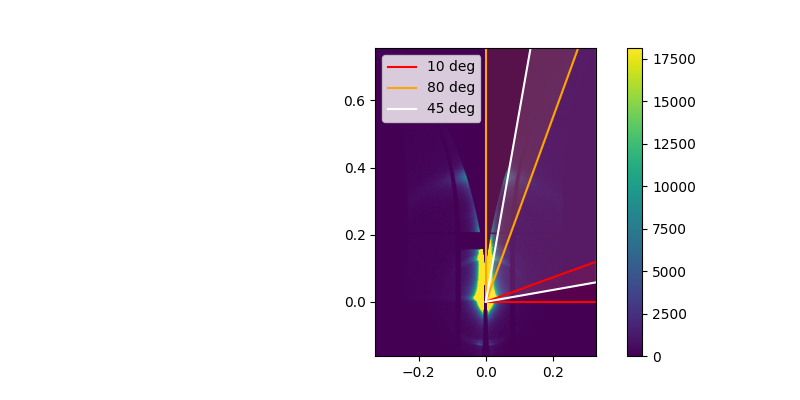

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.541_wa0_bpm119.633_id781481_000000_WAXS.tif,2450.0,0.541


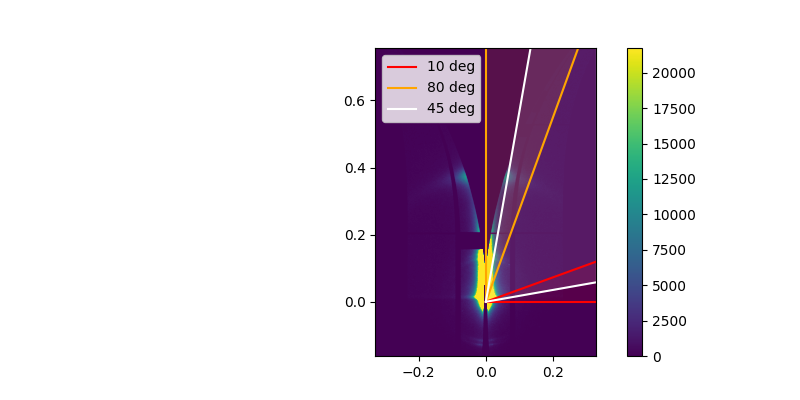

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.661_wa0_bpm119.755_id781521_000000_WAXS.tif,2450.0,0.661


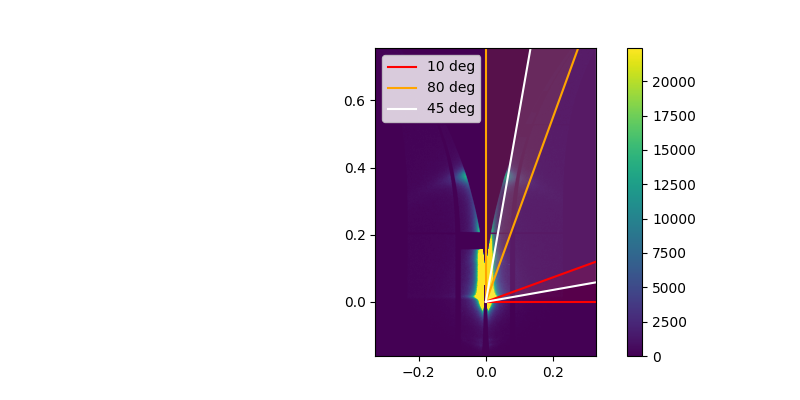

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif,2450.0,3.8


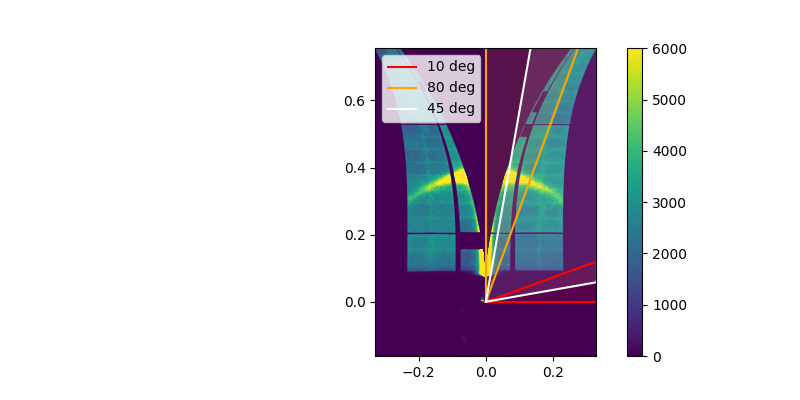

In [12]:
# Define the radial angles
AZIMUTHAL_WIDTH = 10
"""The +- azimuthal width of the orthogonal range"""
AZIMUTHAL_INPLANE = 10
"""The azimuthal angle for the in-plane scattering"""
AZIMUTHAL_OUTOFPLANE = 80
"""The azimuthal angle for the out-of-plane averaging"""
RADIAL_WIDTH = 35
"""The +- azimuthal width for the radial averaging"""
AZIMUTHAL_RADIAL = 45
"""The azimuthal angle for the radial averaging"""

for i, sample in enumerate(samples):
    for test_file in test_files:
        # Setup a figure and open the file
        fname = datasets[i][test_file]
        
        # Collect the metadata
        en_idx = fname.find('eV_')
        en = float(fname[en_idx-7:en_idx])
        ai_idx = fname.find("_ai")
        ai = float(fname[ai_idx+3:ai_idx+8])
        display(pd.DataFrame([
                (fname, en, ai)
                ], columns=["Filename", "Energy (eV)", "Incident Angle (deg)"]))
        
        # Update the geometry
        SMI_waxs.alphai = np.deg2rad(ai)
        SMI_waxs.wav = en2wav(en)

        # Show the angles on a plot
        fig,ax = plt.subplots(1,1, figsize=(8,4), sharex=True, sharey=True)
        ax.set_ylim(SMI_waxs.qz[0], SMI_waxs.qz[-1])
        ax.set_xlim(SMI_waxs.qp[0], SMI_waxs.qp[-1])

        SMI_waxs.open_data(RAW_DIR, [fname])
        apply_detector_mask(SMI_waxs)
        apply_flatfield(SMI_waxs, flatfield)
        SMI_waxs.stitching_data(interp_factor=3, flag_scale=False)
        # mp = ax[1].imshow(SMI_waxs.img_st,
                # extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]], 
        mp = ax.imshow(SMI_waxs.img_st,
                extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]], 
                vmin=np.percentile(SMI_waxs.img_st, 1.0), 
                vmax=np.percentile(SMI_waxs.img_st, 99.0)
        )
        plt.colorbar(mp)

        # Plot the azimuthal and radial angles
        colors = ['r', 'orange', 'white'][::-1]
        for angle, width in zip([AZIMUTHAL_INPLANE, AZIMUTHAL_OUTOFPLANE, AZIMUTHAL_RADIAL], [AZIMUTHAL_WIDTH, AZIMUTHAL_WIDTH, RADIAL_WIDTH]):
                # Generate a set of x points to plot lines of.
                q_x = np.linspace(0, SMI_waxs.qp[-1], 100)
                # Calculate the x and y gradients for the lines
                m1 = np.tan(np.deg2rad(angle - width)) if angle - width != 90 else np.inf
                m2 = np.tan(np.deg2rad(angle + width)) if angle + width != 90 else np.inf
                # Calculate the x & y values for the lines
                q_x1 = q_x if m1 != np.inf else np.zeros(100)
                q_x2 = q_x if m2 != np.inf else np.zeros(100)
                y1 = m1 * q_x if m1 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                y2 = m2 * q_x if m2 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                # Plot the lines
                color = colors.pop()
                ax.plot(q_x1, y1, color=color, linestyle='-', label=f"{angle} deg")
                ax.plot(q_x2, y2, color=color, linestyle='-')
                # If gradient is inf, calculate an alternative fill between
                if m2 == np.inf:
                        ax.fill_betweenx(y1, q_x1, q_x2, color=color, alpha=0.1)
                else:
                        ax.fill_between(q_x, y1, y2, color=color, alpha=0.1)
        ax.legend()
        plt.show()
        # ax.close()


##### Calculate the azimuthal/radial averages

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif,2450.0,0.2


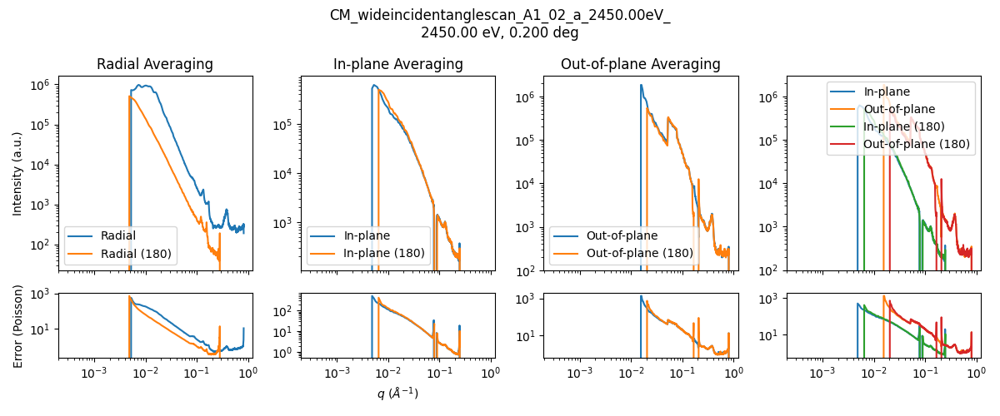

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif,2450.0,0.541


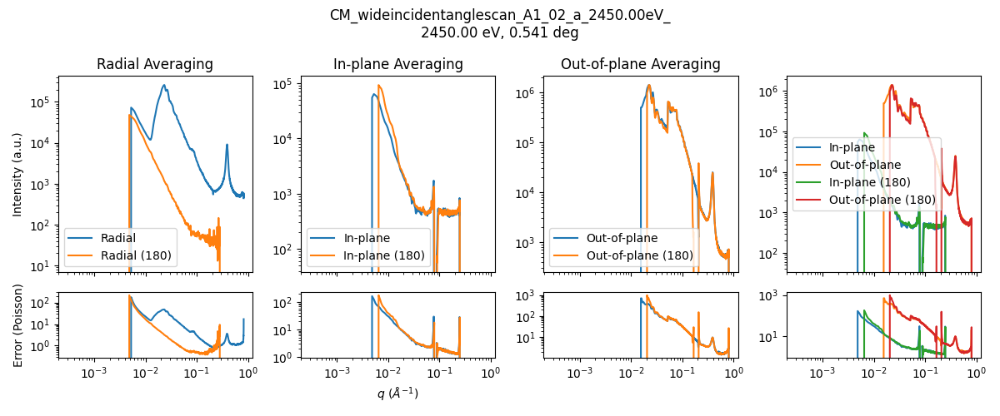

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif,2450.0,0.661


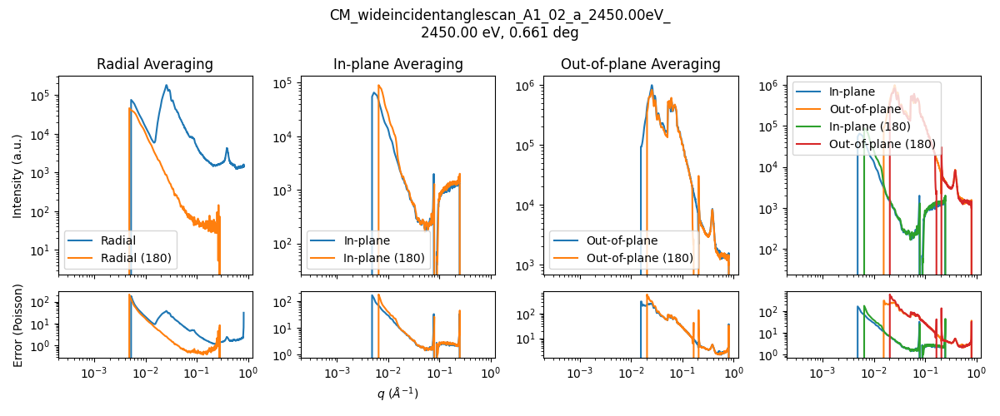

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_02_a_2450.00eV_ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif,2450.0,3.8


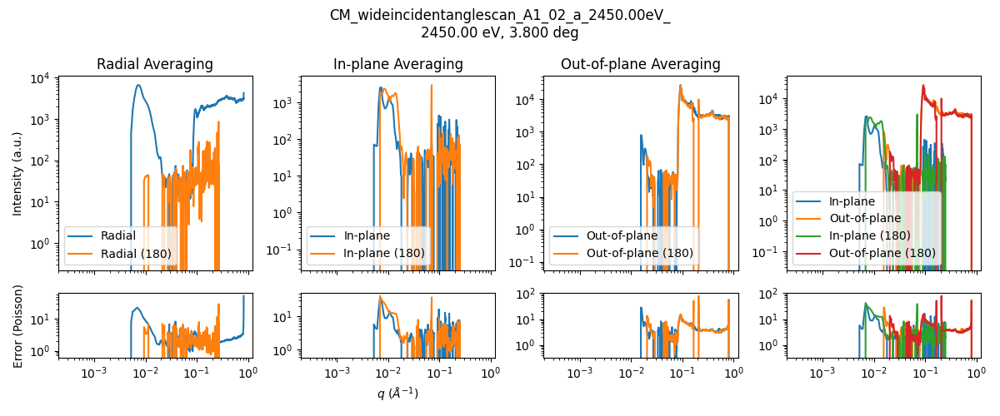

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.200_wa0_bpm119.176_id780788_000000_WAXS.tif,2450.0,0.2


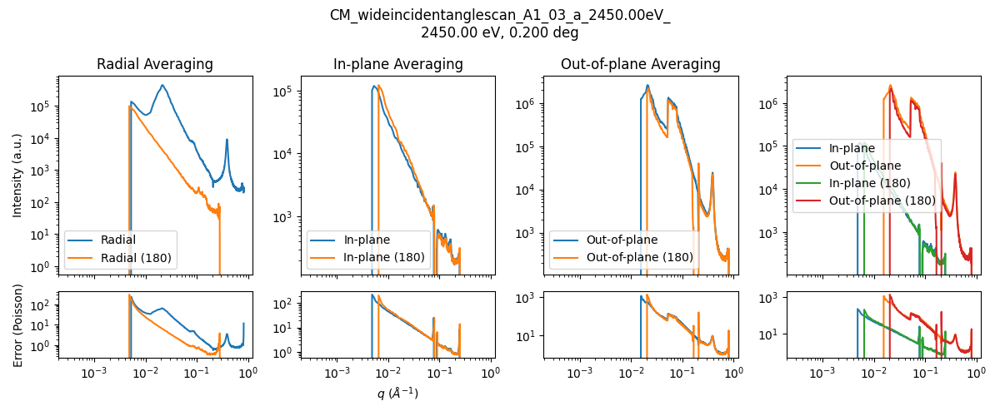

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.541_wa0_bpm119.612_id780828_000000_WAXS.tif,2450.0,0.541


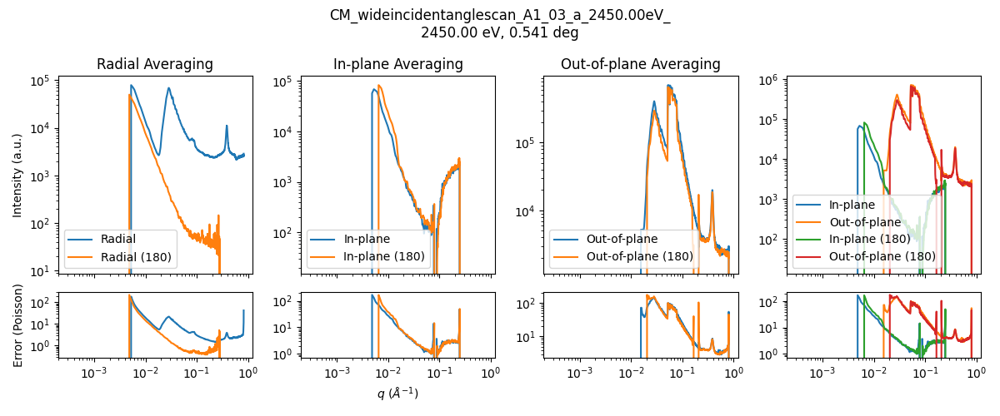

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.661_wa0_bpm119.599_id780868_000000_WAXS.tif,2450.0,0.661


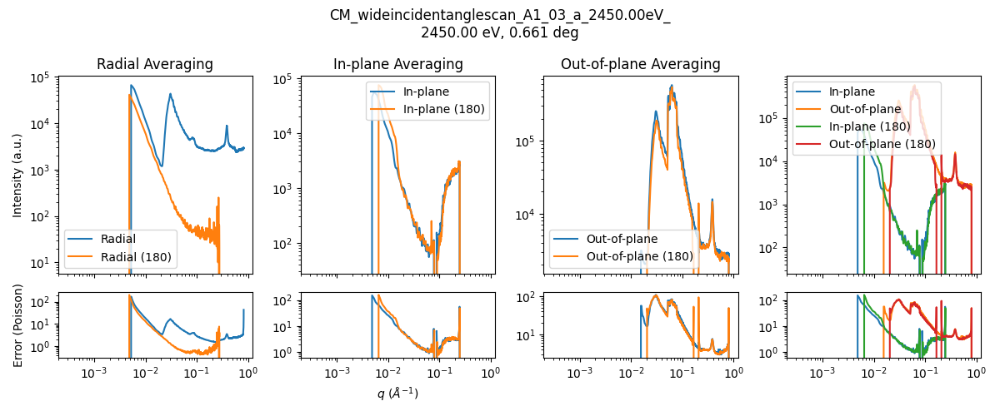

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_03_a_2450.00eV_ai3.800_wa0_bpm119.525_id780925_000000_WAXS.tif,2450.0,3.8


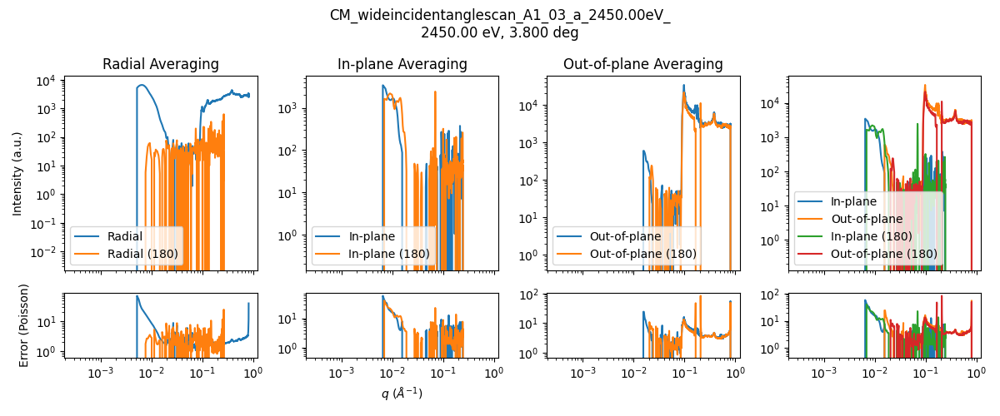

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif,2450.0,0.2


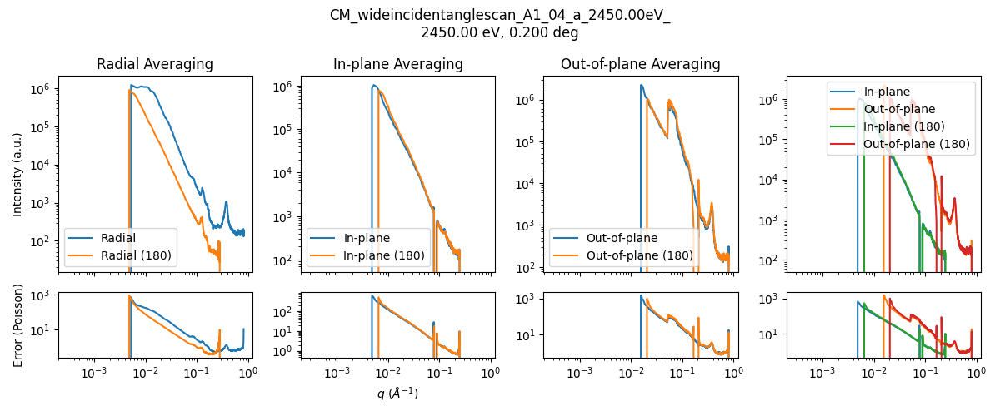

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.541_wa0_bpm119.633_id781481_000000_WAXS.tif,2450.0,0.541


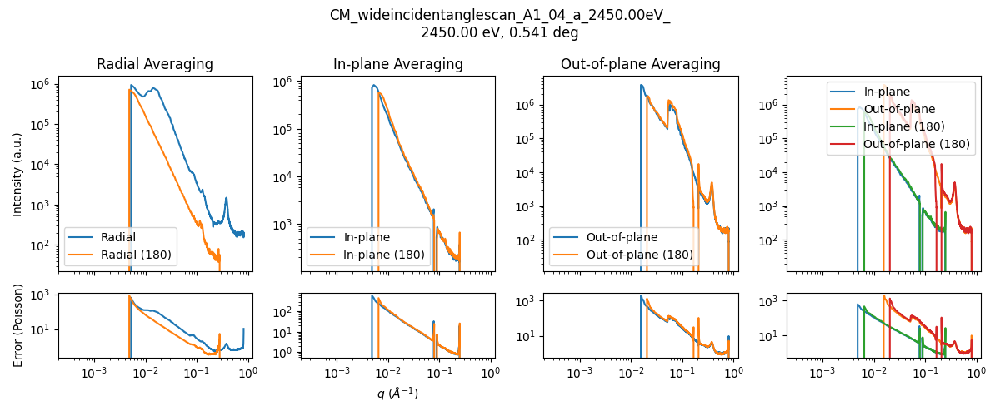

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.661_wa0_bpm119.755_id781521_000000_WAXS.tif,2450.0,0.661


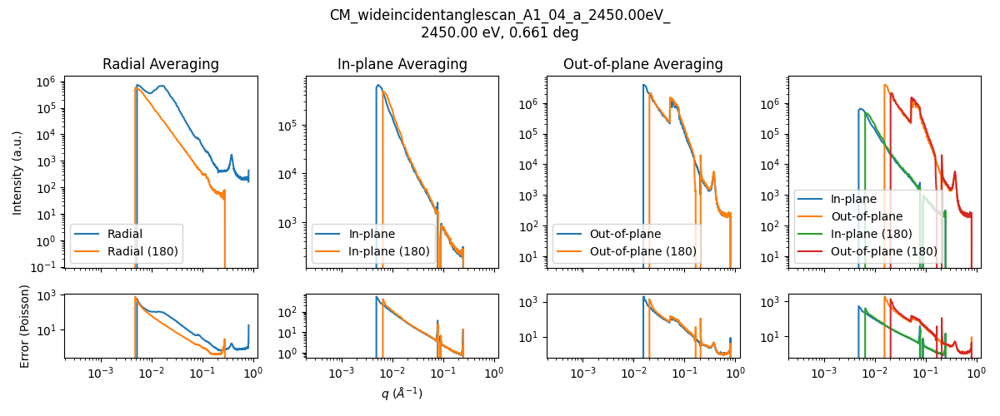

,Filename,Energy (eV),Incident Angle (deg)
0,CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif,2450.0,3.8


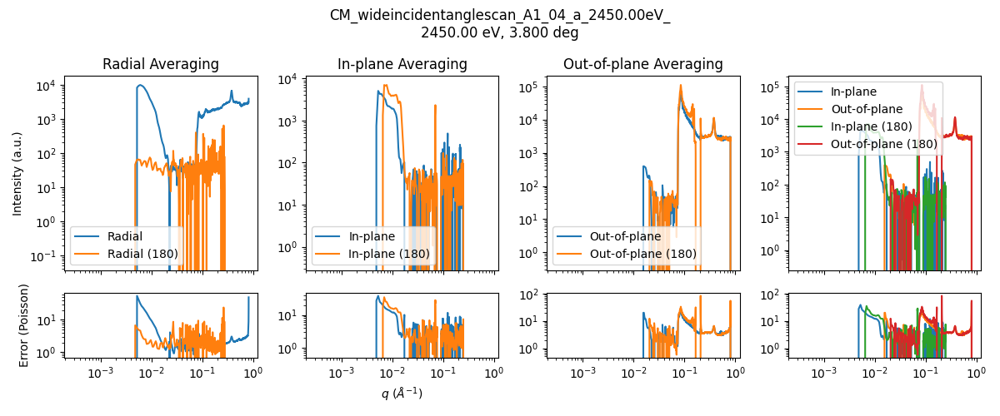

In [13]:
NPOINTS_RADIAL_AVE: int = 2000 # Use a number the is consistent with the pixel density?

for i, sample in enumerate(samples):
    for test_file in test_files:
        # Setup a figure and open the file
        fname = datasets[i][test_file]
        
        # Collect the metadata
        en_idx = fname.find('eV_')
        en = float(fname[en_idx-7:en_idx])
        ai_idx = fname.find("_ai")
        ai = float(fname[ai_idx+3:ai_idx+8])
        display(pd.DataFrame([
                (fname, en, ai)
                ], columns=["Filename", "Energy (eV)", "Incident Angle (deg)"]))
        
        # Update the geometry
        SMI_waxs.alphai = np.deg2rad(ai)
        SMI_waxs.wav = en2wav(en)

        # Open and stitch the data
        SMI_waxs.open_data(RAW_DIR, [fname])
        apply_detector_mask(SMI_waxs)
        apply_flatfield(SMI_waxs, flatfield)
        SMI_waxs.stitching_data(interp_factor=3, flag_scale=False)

        # Generate radial averages
        fig,ax = plt.subplots(2,4, figsize=(12,5), sharex=True, height_ratios=[3,1])
        fig.suptitle(f"{sample}\n{en:0.2f} eV, {ai:0.3f} deg")
        ax[0][0].set_xscale("log")

        # In plane and out of plane
        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[90 - (AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH) , 90 - (AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_IP, I0_IP, I0_IP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[90 - (AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH), 90 - (AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_OOP, I0_OOP, I0_OOP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        # Repeat IP and OOP for the consistency checking
        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[-90+(AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH), -90+(AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_IP2, I0_IP2, I0_IP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[-90+(AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH) , -90+(AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_OOP2, I0_OOP2, I0_OOP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        # Radial averaging
        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[AZIMUTHAL_RADIAL - RADIAL_WIDTH , AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_R, I0_R, I0_R_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        # Repeat radial averaging for consistency checking
        SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                azimuth_range=[180-AZIMUTHAL_RADIAL - RADIAL_WIDTH , 180-AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                npt = NPOINTS_RADIAL_AVE)
        q0_R2, I0_R2, I0_R2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

        # Labels
        ax[1][1].set_xlabel("$q$ ($Å^{-1}$)")
        ax[0][0].set_ylabel("Intensity (a.u.)")
        ax[1][0].set_ylabel("Error (Poisson)")
        ax[0][0].set_title("Radial Averaging")
        ax[0][1].set_title("In-plane Averaging")
        ax[0][2].set_title("Out-of-plane Averaging")
        # Plot the radial averages
        ax[0][0].plot(q0_R, I0_R, label="Radial")
        ax[0][0].fill_between(q0_R, I0_R - I0_R_err, I0_R + I0_R_err, alpha=0.5)
        ax[0][0].plot(q0_R2, I0_R2, label="Radial (180)")
        ax[0][0].fill_between(q0_R2, I0_R2 - I0_R2_err, I0_R2 + I0_R2_err, alpha=0.5)
        # Plot the in-plane and out-of-plane averages
        ax[0][1].plot(q0_IP, I0_IP, label="In-plane")
        ax[0][1].fill_between(q0_IP, I0_IP - I0_IP_err, I0_IP + I0_IP_err, alpha=0.5)
        ax[0][1].plot(q0_IP2, I0_IP2, label="In-plane (180)")
        ax[0][1].fill_between(q0_IP2, I0_IP2 - I0_IP2_err, I0_IP2 + I0_IP2_err, alpha=0.5)
        ax[0][2].plot(q0_OOP, I0_OOP, label="Out-of-plane")
        ax[0][2].fill_between(q0_OOP, I0_OOP - I0_OOP_err, I0_OOP + I0_OOP_err, alpha=0.5)
        ax[0][2].plot(q0_OOP2, I0_OOP2, label="Out-of-plane (180)")
        ax[0][2].fill_between(q0_OOP2, I0_OOP2 - I0_OOP2_err, I0_OOP2 + I0_OOP2_err, alpha=0.5)
        # Overlap the in-plane and out-of-plane averages to check for consistency
        ax[0][3].plot(q0_IP, I0_IP, label="In-plane")
        ax[0][3].fill_between(q0_IP, I0_IP - I0_IP_err, I0_IP + I0_IP_err, alpha=0.5)
        ax[0][3].plot(q0_OOP, I0_OOP, label="Out-of-plane")
        ax[0][3].fill_between(q0_OOP, I0_OOP - I0_OOP_err, I0_OOP + I0_OOP_err, alpha=0.5)
        ax[0][3].plot(q0_IP2, I0_IP2, label="In-plane (180)")
        ax[0][3].fill_between(q0_IP2, I0_IP2 - I0_IP2_err, I0_IP2 + I0_IP2_err, alpha=0.5)
        ax[0][3].plot(q0_OOP2, I0_OOP2, label="Out-of-plane (180)")
        ax[0][3].fill_between(q0_OOP2, I0_OOP2 - I0_OOP2_err, I0_OOP2 + I0_OOP2_err, alpha=0.5)

        # Plot the errors
        ax[1][0].plot(q0_R, I0_R_err, label="Radial")
        ax[1][0].plot(q0_R2, I0_R2_err, label="Radial (180)")
        ax[1][1].plot(q0_IP, I0_IP_err, label="In-plane")
        ax[1][1].plot(q0_IP2, I0_IP2_err, label="In-plane (180)")
        ax[1][2].plot(q0_OOP, I0_OOP_err, label="Out-of-plane")
        ax[1][2].plot(q0_OOP2, I0_OOP2_err, label="Out-of-plane (180)")
        ax[1][3].plot(q0_IP, I0_IP_err, label="In-plane")
        ax[1][3].plot(q0_OOP, I0_OOP_err, label="Out-of-plane")
        ax[1][3].plot(q0_IP2, I0_IP2_err, label="In-plane (180)")
        ax[1][3].plot(q0_OOP2, I0_OOP2_err, label="Out-of-plane (180)")

        for a in ax[0]:
            a.legend()
        for a in ax.flatten():
            a.set_yscale("log")
        fig.tight_layout()
        plt.show()
        # plt.close()

##### If happy with line profiles above, then generate the line profiles for test_data.

In [14]:
OVERRIDE: bool = False
"""Whether to override the analysis reduction or not."""
with tqdm.notebook.tqdm(total=len(samples), position=1, leave=True, desc="Samples") as pbar:
    for i, sample in enumerate(samples):
        # For each file in the sample
        with tqdm.notebook.tqdm(total=len(test_files), position=0, leave=False, desc="Files") as pbar2:
            for test_file in test_files:
                ## Create the results directory for the sample
                sample_dir = os.path.join(RESULT_DIR, sample)
                if not os.path.isdir(sample_dir):
                    os.mkdir(sample_dir)
                    
                ## Create the directories for the images and line profiles
                giwaxs_img_dir = os.path.join(sample_dir, "giwaxs_flatfielded_images")
                if not os.path.isdir(giwaxs_img_dir):
                    os.mkdir(giwaxs_img_dir)
                line_profiles_dir = os.path.join(sample_dir, "line_profiles")
                if not os.path.isdir(line_profiles_dir):
                    os.mkdir(line_profiles_dir)
            
            
                for j, fname in enumerate(datasets[i][test_file:test_file+1]):
                    # Collect the metadata
                    en_idx = fname.find('eV_')
                    en = float(fname[en_idx-7:en_idx])
                    ai_idx = fname.find("_ai")
                    ai = float(fname[ai_idx+3:ai_idx+8])
                    
                    # Generate paths for the output files
                    path_det_img = os.path.join(giwaxs_img_dir, f"{sample}_giwaxs_{en:0.2f}eV_{ai:0.3f}deg.png")
                    path_OOP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt")
                    path_IP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt")
                    path_R = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt")
                    path_det_line_profiles_img = os.path.join(sample_dir, f"{sample}_line_profile_angles_test.png")
                    
                    # Do not override the files if they "all" exist already. Override partial file sets though.
                    if (not OVERRIDE 
                        and os.path.isfile(path_det_img) 
                        and os.path.isfile(path_OOP) 
                        and os.path.isfile(path_IP) 
                        and os.path.isfile(path_R)
                        and (j != 0 or os.path.isfile(path_det_line_profiles_img))):
                        pbar.total -= 1
                        continue
                    
                    # Update the geometry
                    SMI_waxs.alphai = np.deg2rad(ai)
                    SMI_waxs.wav = en2wav(en)
                    
                    # Plot the flatfield / masked normalized data
                    SMI_waxs.open_data(RAW_DIR, [fname])
                    apply_detector_mask(SMI_waxs)
                    apply_flatfield(SMI_waxs, flatfield)
                    SMI_waxs.stitching_data(interp_factor=3, flag_scale=False)
                    
                    # Setup a figure and open the file
                    fig,ax = plt.subplots(1,1, figsize=(7, 10), dpi=300)
                    mp = ax.imshow(SMI_waxs.img_st,
                            extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]],
                            vmin=np.percentile(SMI_waxs.img_st, 1.0), 
                            vmax=np.percentile(SMI_waxs.img_st, 99.0) # Avoid extremities
                    )
                    plt.colorbar(mp)
                    ax.set_title(f"{sample}\n{en} eV - {ai} deg")
                    # Don't save the image, as we use a different display format later.
                    # fig.savefig(path_det_img)
                    
                    
                    if j==0:
                        # Plot the azimuthal and radial angles
                        colors = ['r', 'orange', 'white'][::-1]
                        for angle, width in zip([AZIMUTHAL_INPLANE, AZIMUTHAL_OUTOFPLANE, AZIMUTHAL_RADIAL], [AZIMUTHAL_WIDTH, AZIMUTHAL_WIDTH, RADIAL_WIDTH]):
                            # Generate a set of x points to plot lines of.
                            q_x = np.linspace(0, SMI_waxs.qp[-1], 100)
                            # Calculate the x and y gradients for the lines
                            m1 = np.tan(np.deg2rad(angle - width)) if angle - width != 90 else np.inf
                            m2 = np.tan(np.deg2rad(angle + width)) if angle + width != 90 else np.inf
                            # Calculate the x & y values for the lines
                            q_x1 = q_x if m1 != np.inf else np.zeros(100)
                            q_x2 = q_x if m2 != np.inf else np.zeros(100)
                            y1 = m1 * q_x if m1 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                            y2 = m2 * q_x if m2 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                            # Plot the lines
                            color = colors.pop()
                            ax.plot(q_x1, y1, color=color, linestyle='-', label=f"{angle} deg")
                            ax.plot(q_x2, y2, color=color, linestyle='-')
                            # If gradient is inf, calculate an alternative fill between
                            if m2 == np.inf:
                                    ax.fill_betweenx(y1, q_x1, q_x2, color=color, alpha=0.1)
                            else:
                                    ax.fill_between(q_x, y1, y2, color=color, alpha=0.1)
                        ax.set_xlim(*SMI_waxs.qp)
                        ax.set_ylim(*SMI_waxs.qz)
                        ax.legend()
                        fig.savefig(path_det_line_profiles_img, dpi=300)
                    plt.close() # Save memory
                    
                    # Perform the radial/azimuthal averaging
                    # In plane and out of plane
                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[90 - (AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH) , 90 - (AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_IP, I0_IP, I0_IP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[90 - (AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH), 90 - (AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_OOP, I0_OOP, I0_OOP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                    # Repeat IP and OOP for the consistency checking
                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[-90+(AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH), -90+(AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_IP2, I0_IP2, I0_IP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[-90+(AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH) , -90+(AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_OOP2, I0_OOP2, I0_OOP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                    # Radial averaging
                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[AZIMUTHAL_RADIAL - RADIAL_WIDTH , AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_R, I0_R, I0_R_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                    # Repeat radial averaging for consistency checking
                    SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                            azimuth_range=[180-AZIMUTHAL_RADIAL - RADIAL_WIDTH , 180-AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                            npt = NPOINTS_RADIAL_AVE)
                    q0_R2, I0_R2, I0_R2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err
                    
                    # Save the line profiles 
                    header = ("Main Data\t\tMirror-Y axis Data\t\n" 
                            + "q (Å^-1)\tI (a.u.)\tI_err (a.u.)\tq (Å^-1)\tI (a.u.)\tI_err (a.u.)\n")
                    delim = "\t"
                    kwargs = {"header": header, "delimiter": delim}
                    np.savetxt(path_OOP, np.array([q0_OOP, I0_OOP, I0_OOP_err, q0_OOP2, I0_OOP2, I0_OOP2_err]).T, **kwargs)
                    np.savetxt(path_IP, np.array([q0_IP, I0_IP, I0_IP_err, q0_IP2, I0_IP2, I0_IP2_err]).T, **kwargs)
                    np.savetxt(path_R, np.array([q0_R, I0_R, I0_R_err, q0_R2, I0_R2, I0_R2_err]).T, **kwargs)
                    
                    # Update the progress bars
                    pbar2.update(1)
        pbar.update(1)

Samples:   0%|          | 0/3 [00:00<?, ?it/s]

Files:   0%|          | 0/4 [00:00<?, ?it/s]

Files:   0%|          | 0/4 [00:00<?, ?it/s]

Files:   0%|          | 0/4 [00:00<?, ?it/s]

### Setup Fitting
##### Define q regions for truncation, where summation can be performed to observe changes in amplitude

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif


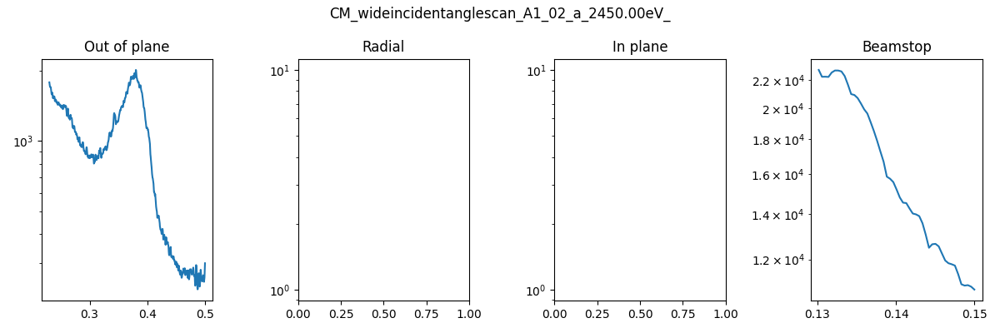

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif


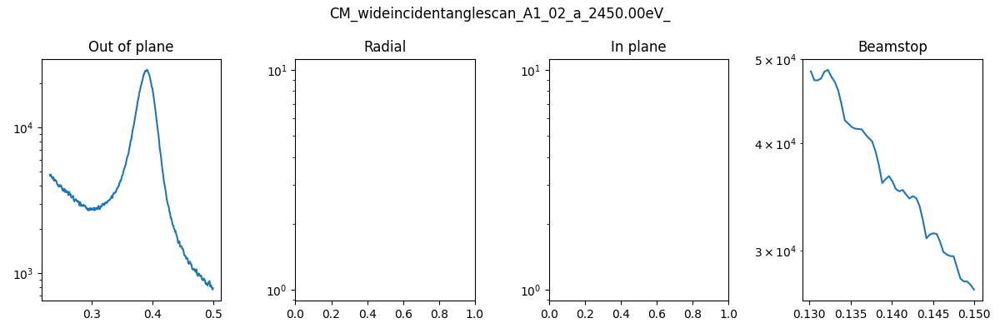

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif


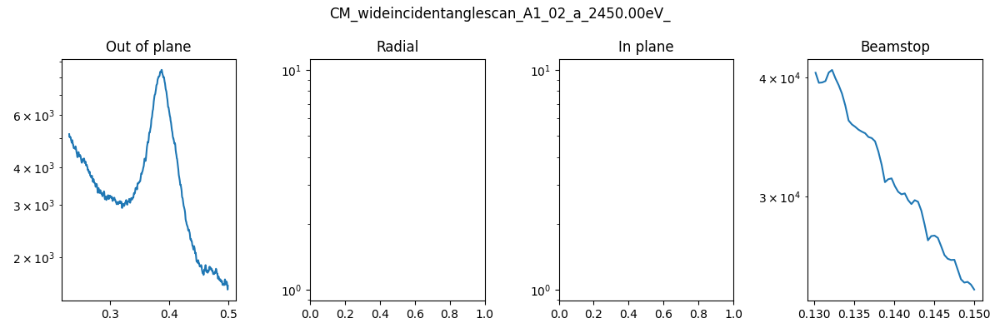

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif


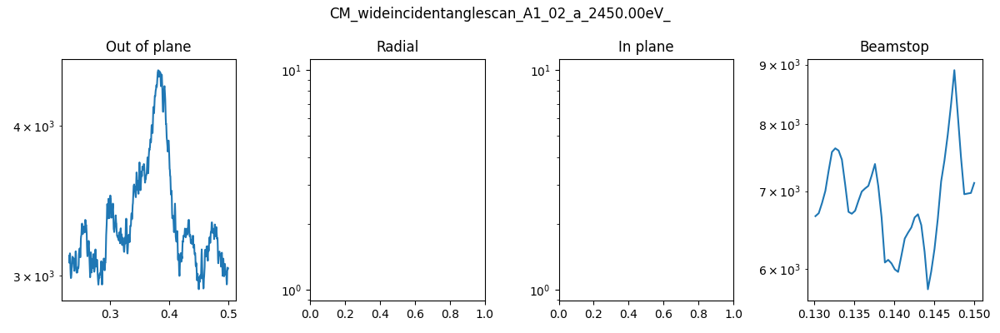

In [15]:
# Define the q-range for the peaks
VERT_PEAKS: list[tuple[float, float]] = [(0.23, 0.5),
                                    # (0.5, 0.75), etc.
                                    ]
"""A list of tuples defining the q-range fitting for each peak of interest in the out-of-plane direction"""
HOR_PEAKS: list[tuple[float, float]] = []
"""A list of tuples defining the q-range fitting for each peak of interest in the in-plane direction"""
RAD_PEAKS: list[tuple[float, float]] = []
"""A list of tuples defining the q-range fitting for each peak of interest across the azimuthal"""

VERT_BEAMSTOP: tuple[float, float] = (0.13, 0.15)
"""A q-range specifying a q-range to collect the change in beamstop intensity"""

for i, sample in enumerate(samples):
    for test_file in test_files:
        # Setup a figure and open the file
        fname = datasets[i][test_file]
        print(fname)
        # Collect the metadata
        en_idx = fname.find('eV_')
        en = float(fname[en_idx-7:en_idx])
        ai_idx = fname.find("_ai")
        ai = float(fname[ai_idx+3:ai_idx+8])
        
        # Collect the line profiles from disk
        sample_dir = os.path.join(RESULT_DIR, sample)
        line_profiles_dir = os.path.join(sample_dir, "line_profiles")
        if not os.path.isdir(line_profiles_dir):
            os.mkdir(line_profiles_dir)
        path_OOP = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt"))
        path_IP = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt"))
        path_R = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt"))
        
        data_OOP = np.loadtxt(path_OOP, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_OOP, I0_OOP, I0_OOP_err = data_OOP[0], data_OOP[1], data_OOP[2]
        data_IP = np.loadtxt(path_IP, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_IP, I0_IP, I0_IP_err = data_IP[0], data_IP[1], data_IP[2]
        data_R = np.loadtxt(path_R, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_R, I0_R, I0_R_err = data_R[0], data_R[1], data_R[2]

        # Find the q-range to the region of interest
        if len(VERT_PEAKS) > 0:
            idx_OOP = np.where((q0_OOP > np.min(VERT_PEAKS)) & (q0_OOP < np.max(VERT_PEAKS)))
        else:
            idx_OOP = np.arange(len(q0_OOP))
        if len(HOR_PEAKS) > 0:
            idx_IP = np.where((q0_IP > np.min(HOR_PEAKS)) & (q0_IP < np.max(HOR_PEAKS)))
        else:
            idx_IP = np.arange(len(q0_IP))
        if len(RAD_PEAKS) > 0:
            idx_R = np.where((q0_R > np.min(RAD_PEAKS)) & (q0_R < np.max(RAD_PEAKS)))
        else:
            idx_R = np.arange(len(q0_R))
        # Collect the beamstop region
        idx_BS = np.where((q0_OOP > np.min(VERT_BEAMSTOP)) & (q0_OOP < np.max(VERT_BEAMSTOP)))
            
        # Truncate the data to the region of interest
        q0_OOP_TR, I0_OOP_TR, I0_OOP_err_TR = q0_OOP[idx_OOP], I0_OOP[idx_OOP], I0_OOP_err[idx_OOP]
        q0_IP_TR, I0_IP_TR, I0_IP_err_TR = q0_IP[idx_IP], I0_IP[idx_IP], I0_IP_err[idx_IP]
        q0_R_TR, I0_R_TR, I0_R_err_TR = q0_R[idx_R], I0_R[idx_R], I0_R_err[idx_R]

        # Plot the data
        fig, ax = plt.subplots(max([len(VERT_PEAKS), len(HOR_PEAKS), len(RAD_PEAKS)]), 4, figsize=(12,4))
        if len(ax.shape) == 1:
            ax = ax.reshape(1,4)
        for i, peak in enumerate(VERT_PEAKS):
            idx = (q0_OOP_TR > peak[0]) & (q0_OOP_TR < peak[1])
            ax[i][0].plot(q0_OOP_TR[idx], I0_OOP_TR[idx], label="Out of plane")
            ax[i][0].fill_between(q0_OOP_TR[idx], (I0_OOP_TR - I0_OOP_err_TR)[idx], (I0_OOP_TR + I0_OOP_err_TR)[idx], alpha=0.5)
        for i, peak in enumerate(RAD_PEAKS):
            idx = (q0_R_TR > peak[0]) & (q0_R_TR < peak[1])
            ax[i][1].plot(q0_R_TR[idx], I0_R_TR[idx], label="Radial")
            ax[i][1].fill_between(q0_R_TR[idx], (I0_R_TR - I0_R_err_TR)[idx], (I0_R_TR + I0_R_err_TR)[idx], alpha=0.5)
        for i, peak in enumerate(HOR_PEAKS):
            idx = (q0_IP_TR > peak[0]) & (q0_IP_TR < peak[1])
            ax[i][2].plot(q0_IP_TR[idx], I0_IP_TR[idx], label="In plane")
            ax[i][2].fill_between(q0_IP_TR[idx], (I0_IP_TR - I0_IP_err_TR)[idx], (I0_IP_TR + I0_IP_err_TR)[idx], alpha=0.5)
        ax[0][0].set_title("Out of plane")
        ax[0][1].set_title("Radial")
        ax[0][2].set_title("In plane")

        for a in ax.flatten():
            # a.set_xscale("log")
            a.set_yscale("log")
        # Plot the area under the beamstop region
        ax[0][3].plot(q0_OOP[idx_BS], I0_OOP[idx_BS], label="Beamstop")
        ax[0][3].fill_between(q0_OOP[idx_BS], I0_OOP[idx_BS] - I0_OOP_err[idx_BS], I0_OOP[idx_BS] + I0_OOP_err[idx_BS], alpha=0.5)
        ax[0][3].set_title("Beamstop")
        fig.suptitle(sample)
        # plt.close()
        fig.tight_layout()
        plt.show()
    break

##### Attempt some fitting of the peaks
###### Define the peakfit functions

In [16]:
power_law = lambda x, a=1, b=-1, c=0: a * (x-c)**b
"""A power law function for fitting the data

Parameters
----------
    a : float
        The amplitude of the power law, by default 1
    b : float
        The power of the power law, by default -1
    c : float
        The translational offset of the power law, by default 0
"""

lorentz = lambda x, a=1, b=1, c=1: a * c / ((x - b)**2 + c**2)
"""A Lorentzian function for fitting the data

Parameters
----------
    a : float
        The amplitude of the Lorentzian, by default 1
    b : float
        The peak position of the Lorentzian, by default 1
    c : float
        The width of the Lorentzian, by default 1
"""

gauss = lambda x, a=1, b=1, c=1: a * np.exp(-((x - b)**2) / (2 * c**2))
"""A Gaussian function for fitting the data

Parameters
----------
    a : float
        The amplitude of the Gaussian, by default 1
    b : float
        The peak position of the Gaussian, by default 1
    c : float
        The width of the Gaussian, by default 1
"""
# # Without power law centre:
fit_fn_lor = lambda x, a,b,c,d,e,f: np.sqrt((lorentz(x,a,b,c) + power_law(x,d,e))**2 + f**2)
fit_fn_lor_log = lambda x, a,b,c,d,e,f: np.log(fit_fn_lor(x,a,b,c,d,e,f))
fit_fn_gau = lambda x, a,b,c,d,e,f: np.sqrt((gauss(x,a,b,c) + power_law(x,d,e))**2 + f**2)
fit_fn_gau_log = lambda x, a,b,c,d,e,f: np.log(fit_fn_gau(x,a,b,c,d,e,f))

# fit_fn_lor_sin = lambda x, a,b,c,d,e,f,g,h,i: np.sqrt((lorentz(x,a,b,c) + power_law(x,d,e) + h*np.sin(x*2*np.pi*f - g*np.pi/180)**2)**2 + i**2)

In [39]:
print(any(["A1_04" in file for  file in datasets[2]]))

True


##### Create a reasonable guess close to the optimum

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,37.656510,0.374333,0.023192,11.249050,-3.458065,107.527507
OOP Peak #0 Error,0.787138,0.000226,0.000461,1.446652,0.093151,17.450464


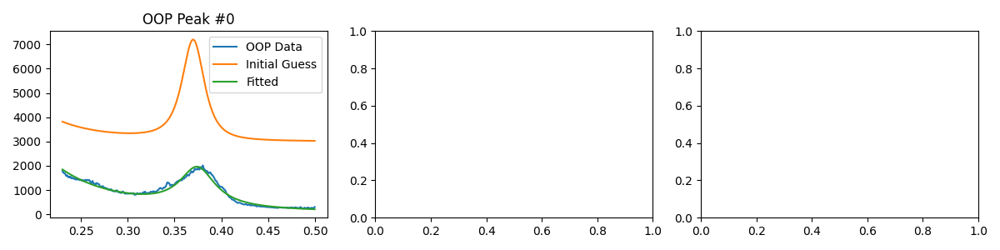

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.541_wa0_bpm119.489_id780174_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,356.192061,0.388156,0.014286,26.879614,-3.560149,0.000023
OOP Peak #0 Error,2.610585,0.000096,0.000141,3.103330,0.085746,0.000000


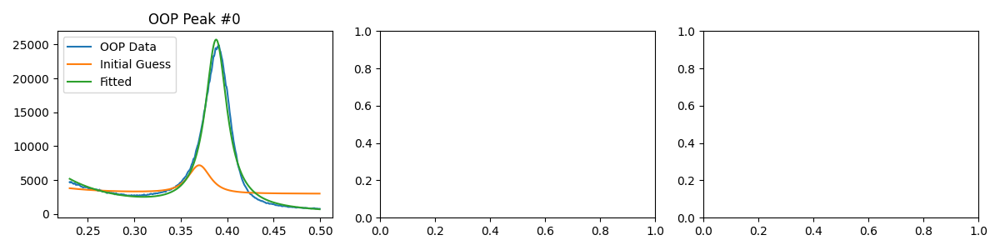

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.661_wa0_bpm119.563_id780214_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,148.519584,0.386879,0.021520,100.620301,-2.640505,1327.624184
OOP Peak #0 Error,0.882764,0.000057,0.000119,4.427459,0.031602,13.653754


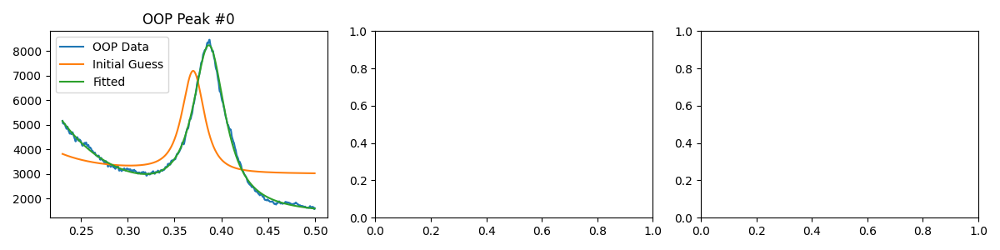

CM_wideincidentanglescan_A1_02_a_2450.00eV_ai3.800_wa0_bpm119.223_id780271_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,64.623577,0.380931,0.024536,183.713356,-1.000000,3059.738951
OOP Peak #0 Error,9.314694,0.000330,0.001715,226.991847,0.716797,49.312758


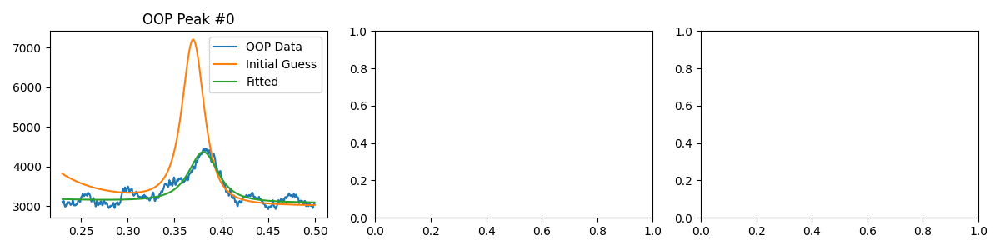

CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.200_wa0_bpm119.176_id780788_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,318.661785,0.387162,0.012695,9.385493,-4.404096,0.000076
OOP Peak #0 Error,2.896577,0.000116,0.000159,1.460191,0.115030,0.000000


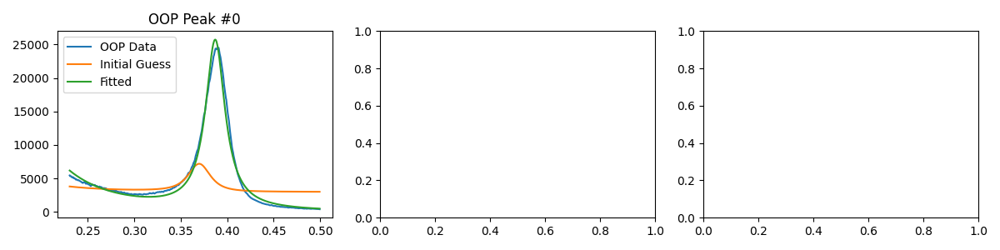

CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.541_wa0_bpm119.612_id780828_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,261.269164,0.385055,0.014011,253.559466,-1.757814,2594.097823
OOP Peak #0 Error,1.540983,0.000033,0.000074,23.557483,0.062902,27.595441


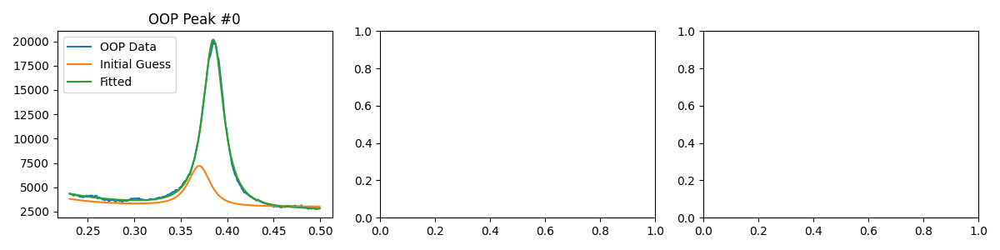

CM_wideincidentanglescan_A1_03_a_2450.00eV_ai0.661_wa0_bpm119.599_id780868_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,213.119339,0.385210,0.014906,289.105352,-1.518537,2851.317823
OOP Peak #0 Error,2.044149,0.000044,0.000114,39.507112,0.089720,32.653511


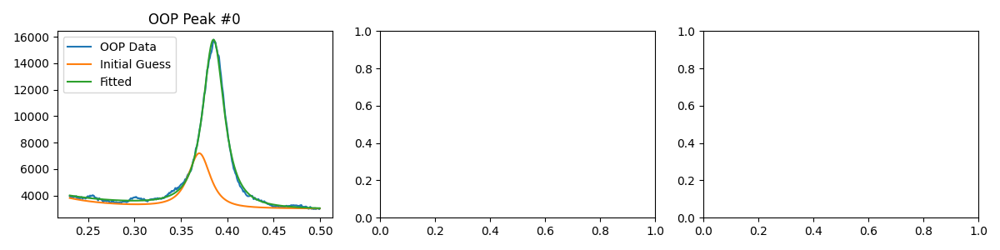

CM_wideincidentanglescan_A1_03_a_2450.00eV_ai3.800_wa0_bpm119.525_id780925_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,89.125434,0.382579,0.018318,194.349286,-1.000000,3032.306477
OOP Peak #0 Error,4.718835,0.000132,0.000556,128.168445,0.385156,33.885412


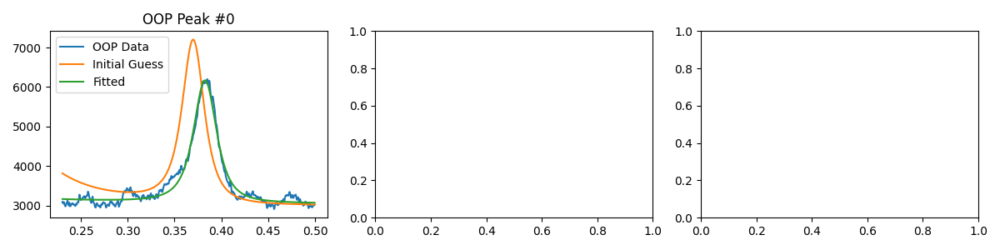

CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,52.595047,0.372893,0.020295,8.609076,-3.574112,14.683627
OOP Peak #0 Error,0.756927,0.000163,0.000306,1.214446,0.102230,111.249987


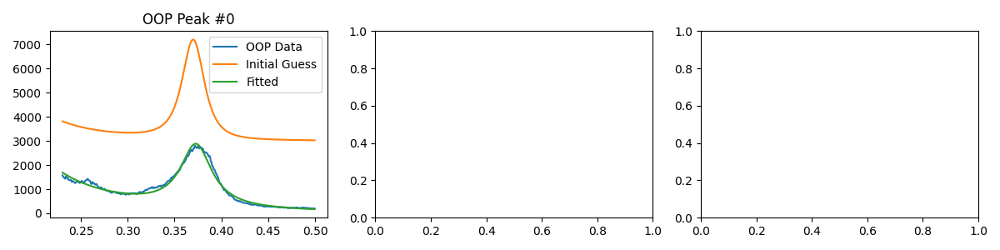

CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.541_wa0_bpm119.633_id781481_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,71.223002,0.375053,0.018438,11.603011,-3.666331,0.000001
OOP Peak #0 Error,0.664487,0.000124,0.000210,0.724303,0.045952,0.000000


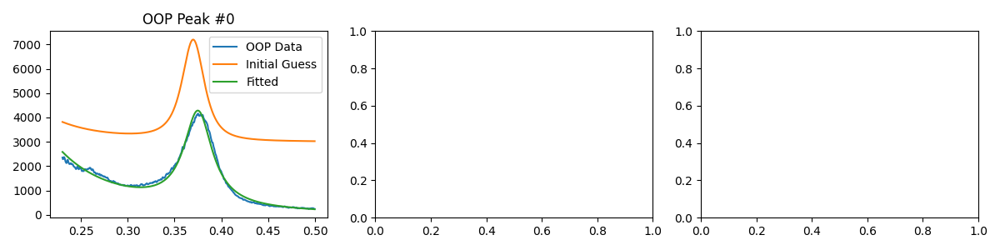

CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.661_wa0_bpm119.755_id781521_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,78.832294,0.376207,0.017483,14.324394,-3.625432,0.000001
OOP Peak #0 Error,0.683567,0.000113,0.000188,0.793217,0.040956,0.000000


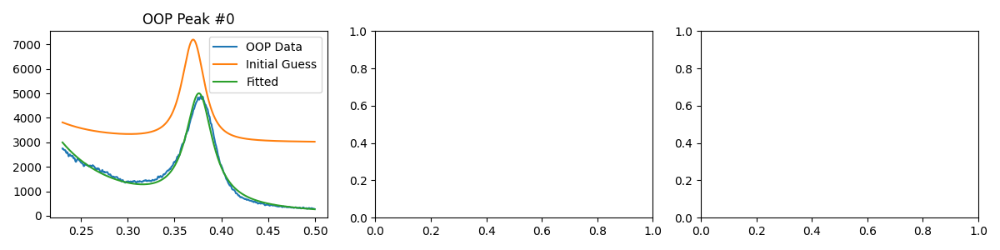

CM_wideincidentanglescan_A1_04_a_2450.00eV_ai3.800_wa0_bpm119.510_id781578_000000_WAXS.tif


,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
OOP Peak #0 Fit,142.891771,0.379451,0.014629,208.762755,-1.000000,2960.010665
OOP Peak #0 Error,3.128507,0.000070,0.000228,87.469737,0.252242,29.333398


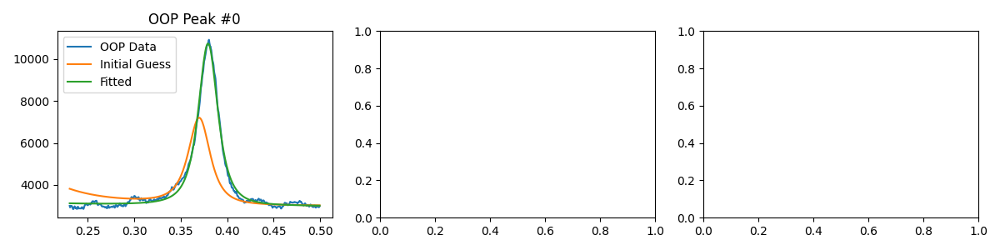

In [41]:
# Define the initial guesses for the peaks
VERT_GUESSES: list[tuple] = [
    (100,	0.37,	0.017,	50,	-2.6,	3000),
]
"""A list of tuples defining the initial guesses for each out-of-plane peak of interest"""
HOR_GUESSES: list[tuple] = []
"""A list of tuples defining the initial guesses for each in-plane peak of interest"""
RAD_GUESSES: list[tuple] = []
"""A list of tuples defining the initial guesses for each radial peak of interest"""

# Define the parameter labels
VERT_LABELS: list[list[str]] = [
    # ["Gauss Amp.", "Gauss Centre", "Gauss Width", "Powerlaw Amplitude", "Powerlaw Power", "Offset"]
    ["Lorentz Amp.", "Lorentz Centre", "Lorentz Width", "Powerlaw Amplitude", "Powerlaw Power", "Offset"]
    # ["Lorentz Amp.", "Lorentz Centre", "Lorentz Width", "Powerlaw Amplitude", "Powerlaw Power", "Sin Freq.", "Sin Phase", "Sin Amp.", "Offset"]
]
"""A list of lists defining the labels for the fitting parameters for each out-of-plane peak"""
HOR_LABELS: list[list[str]] = []
"""A list of lists defining the labels for the fitting parameters for each in-plane peak"""
RAD_LABELS: list[list[str]] = []
"""A list of lists defining the labels for the fitting parameters for each radial peak"""

# Fitting functions
# VERT_FIT_FNS: list[Callable] = [fit_fn_lor_sin]
VERT_FIT_FNS: list[Callable] = [fit_fn_lor]
# VERT_FIT_FNS: list[Callable] = [fit_fn_gau]
"""A list of fitting functions for the out-of-plane peaks"""
HOR_FIT_FNS: list[Callable] = []
"""A list of fitting functions for the in-plane peaks"""
RAD_FIT_FNS: list[Callable] = []
"""A list of fitting functions for the radial peaks"""

#Bounds
# VERT_LB : list[tuple | None] = [(0, 0, 0, 0, -np.inf, 0, -180, 0, 0)]
VERT_LB : list[tuple | None] = [(0, 0.36, 0.001, 0, -np.inf, 0)]
"""List of tuples defining the lower bounds for the fitting parameters for each out-of-plane peak"""
# VERT_UB : list[tuple | None] = [(np.inf, np.inf, np.inf, np.inf, -1, np.inf, 180, np.inf, np.inf)]
VERT_UB : list[tuple | None] = [(np.inf, 0.4, 0.04, np.inf, -1, np.inf)]
"""List of tuples defining the upper bounds for the fitting parameters for each out-of-plane peak"""
VERT_BOUNDS : list[tuple[tuple | None, tuple | None] | None] = [(VERT_LB[i], VERT_UB[i]) for i in range(len(VERT_LB))]
"""List of tuples of lower-bound/upper-bound tuples, defining the bounds for the fitting parameters for each out-of-plane peak"""
HOR_LB : list[tuple | None] = []
"""List of tuples defining the lower bounds for the fitting parameters for each in-plane peak"""
HOR_UB : list[tuple | None] = []
"""List of tuples defining the upper bounds for the fitting parameters for each in-plane peak"""
HOR_BOUNDS : list[tuple[tuple | None, tuple | None] | None] = [(HOR_LB[i], HOR_UB[i]) for i in range(len(HOR_LB))]
"""List of tuples of lower-bound/upper-bound tuples, defining the bounds for the fitting parameters for each in-plane peak"""
RAD_LB : list[tuple | None] = []
"""List of tuples defining the lower bounds for the fitting parameters for each radial peak"""
RAD_UB : list[tuple | None] = []
"""List of tuples defining the upper bounds for the fitting parameters for each radial peak"""
RAD_BOUNDS : list[tuple[tuple | None, tuple | None] | None] = [(RAD_LB[i], RAD_UB[i]) for i in range(len(RAD_LB))]
"""List of tuples of lower-bound/upper-bound tuples, defining the bounds for the fitting parameters for each radial peak"""

# Convert (None, None) tuples to None for the bounds
VERT_BOUNDS = [None if bounds == (None, None) else bounds for bounds in VERT_BOUNDS]
HOR_BOUNDS = [None if bounds == (None, None) else bounds for bounds in HOR_BOUNDS]
RAD_BOUNDS = [None if bounds == (None, None) else bounds for bounds in RAD_BOUNDS]

# Check the number of guesses matches the number of peaks
assert len(VERT_PEAKS) == len(VERT_GUESSES) == len(VERT_BOUNDS) == len(VERT_LABELS), "The number of guesses must match the number of peaks and bounds."
assert len(HOR_PEAKS) == len(HOR_GUESSES) == len(HOR_BOUNDS) == len(HOR_LABELS), "The number of guesses must match the number of peaks and bounds."
assert len(RAD_PEAKS) == len(RAD_GUESSES) == len(RAD_BOUNDS) == len(RAD_LABELS), "The number of guesses must match the number of peaks and bounds."

# Pack the fitting functions, guesses and bounds into a single iterable
FIT_REGISTER: list[tuple[Literal["OOP"] | Literal["IP"] | Literal["RAD"],
                         tuple[float, float],
                         Callable, 
                         tuple, 
                         tuple[tuple | None, tuple | None] | None,
                         list[str]]
                   ] = []
"""A list of tuples defining:
    1. The peak type (e.g. 'OOP', 'IP', 'RAD')
    2. The peak q-range
    3. The fitting function
    4. The initial guesses tuple
    5. The bounds tuple (lower|None, upper|None) | None matching length of guesses tuple.
    6. The list of parameter labels (corresponding to 4,5).
"""
for i, peak in enumerate(VERT_PEAKS):
    FIT_REGISTER.append(("OOP", peak, VERT_FIT_FNS[i], VERT_GUESSES[i], VERT_BOUNDS[i], VERT_LABELS[i]))
for i, peak in enumerate(HOR_PEAKS):
    FIT_REGISTER.append(("IP", peak, HOR_FIT_FNS[i], HOR_GUESSES[i], HOR_BOUNDS[i], HOR_LABELS[i]))
for i, peak in enumerate(RAD_PEAKS):
    FIT_REGISTER.append(("RAD", peak, RAD_FIT_FNS[i], RAD_GUESSES[i], RAD_BOUNDS[i], RAD_LABELS[i]))

# Display the initial guesses over the data
FIT_N = max([len(VERT_PEAKS), len(HOR_PEAKS), len(RAD_PEAKS)])

for i, sample in enumerate(samples):
    for test_file in test_files:
        # Setup a figure and open the file
        fname = datasets[i][test_file]
        print(fname)
        # Collect the metadata
        en_idx = fname.find('eV_')
        en = float(fname[en_idx-7:en_idx])
        ai_idx = fname.find("_ai")
        ai = float(fname[ai_idx+3:ai_idx+8])
        
        # Collect the line profiles from disk
        sample_dir = os.path.join(RESULT_DIR, sample)
        line_profiles_dir = os.path.join(sample_dir, "line_profiles")
        if not os.path.isdir(line_profiles_dir):
            os.mkdir(line_profiles_dir)
        path_OOP = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt"))
        path_IP = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt"))
        path_R = os.path.normpath(os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt"))
        
        data_OOP = np.loadtxt(path_OOP, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_OOP, I0_OOP, I0_OOP_err = data_OOP[0], data_OOP[1], data_OOP[2]
        data_IP = np.loadtxt(path_IP, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_IP, I0_IP, I0_IP_err = data_IP[0], data_IP[1], data_IP[2]
        data_R = np.loadtxt(path_R, delimiter="\t", unpack=True, skiprows=2, dtype=float)
        q0_R, I0_R, I0_R_err = data_R[0], data_R[1], data_R[2]

        fig, ax = plt.subplots(FIT_N, 3, figsize=(12,3*FIT_N))
        if len(ax.shape) == 1:
            ax = ax.reshape(1,3)

        counts = [0, 0, 0] # Count the number of peaks for each direction
        for k, fit in enumerate(FIT_REGISTER):
            peak_type, peak_range, fit_fn, guess, bounds, labels = fit
            match peak_type:
                case "OOP":
                    j = 0
                    q, I, I_err = q0_OOP, I0_OOP, I0_OOP_err
                case "IP":
                    j = 1
                    q, I, I_err = q0_IP, I0_IP, I0_IP_err
                case "RAD":
                    j = 2
                    q, I, I_err = q0_R, I0_R, I0_R_err
            idxs = np.where((q > peak_range[0]) & (q < peak_range[1]))
            q = q[idxs]
            I = I[idxs]
            I_err = I_err[idxs]
            
            ax[j][counts[j]].set_title(f"{peak_type} Peak #{k}")
            ax[j][counts[j]].plot(q, I, label=f"{peak_type} Data")
            ax[j][counts[j]].fill_between(q, I - I_err, I + I_err, alpha=0.5)
            ax[j][counts[j]].plot(q, fit_fn(q, *VERT_GUESSES[k]), label="Initial Guess")
            popt, pcov = curve_fit(fit_fn, q, I, p0=guess, sigma=I_err, maxfev=100000, bounds=bounds)
            ax[j][counts[j]].plot(q, fit_fn(q, *popt), label="Fitted")
            ax[j][counts[j]].legend()
            display(pd.DataFrame(
                [popt, np.sqrt(np.diag(pcov))],
                columns=labels,
                index=[f"{peak_type} Peak #{k} Fit", f"{peak_type} Peak #{k} Error"]
            ))
            counts[j] += 1
        fig.tight_layout()
        plt.show()

### Use Monte-Carlo Markov Chains to see if the Least Squares solution is really a good fit of random variables
##### Define the likelihood, prior and probability functions

In [18]:
def gen_fns(fit_fn: Callable, bounds: tuple[tuple | None, tuple | None] | None) -> tuple[Callable, Callable, Callable]:
    """Genereate the log-likelihood, log-prior and log-probability functions for the fitting"""
    def log_likelihood(theta, x, y, yerr, fit_fn: Callable = fit_fn) -> float:
        model_y = fit_fn(x, *theta)
        sigma2 = yerr**2
        return -0.5 * np.sum((y - model_y)**2 / sigma2 )
    
    def log_prior(theta, bounds: tuple[tuple | None, tuple | None] | None = bounds) -> float:
        """Define the log-prior function for the fitting"""
        if bounds is None:
            return 0.0
        lb, ub = bounds
        # Return -np.inf if out of bounds.
        if lb is not None:
            for i in range(len(theta)):
                if lb[i] is not None:
                    if lb[i] > theta[i]:
                        return -np.inf
        if not ub is None:
            for i in range(len(theta)):
                if ub[i] is not None:
                    if ub[i] < theta[i]:
                        return -np.inf
        return 0.0
    
    def log_probability(theta, x, y, yerr, lprior: Callable = log_prior, llikelihood: Callable = log_likelihood) -> float:
        """Define the log-probability function for the fitting"""
        lp = lprior(theta)
        if not np.isfinite(lp):
            return -np.inf
        return lp + llikelihood(theta, x, y, yerr)
    
    return log_likelihood, log_prior, log_probability

LOG_LIKELIHOOD_FNS: list[Callable] = []
"""A list of log-likelihood functions for each peak. By default a Gaussian log-likelihood function is used for each parameter, but can be redefined."""
LOG_PRIOR_FNS: list[Callable] = []
"""A list of log-prior functions for each peak. By default no prior is defined, but can be redefined."""
LOG_PROBABILITY_FNS: list[Callable] = []

for i, fit in enumerate(FIT_REGISTER):
    peak_type, peak_range, fit_fn, guess, bounds, labels = fit
    log_likelihood, log_prior, log_probability = gen_fns(fit_fn, bounds)
    LOG_LIKELIHOOD_FNS.append(log_likelihood)
    LOG_PRIOR_FNS.append(log_prior)
    LOG_PROBABILITY_FNS.append(log_probability)

# Test the log_probability function - should be non-infinite if working.
LOG_PROBABILITY_FNS[0](
    theta=VERT_GUESSES[0],
    x=q0_OOP_TR, 
    y=I0_OOP_TR, 
    yerr=np.sqrt(I0_OOP_TR),
    lprior=LOG_PRIOR_FNS[0],
    llikelihood=LOG_LIKELIHOOD_FNS[0]
)

np.float64(-411694.54919841577)

##### Use emcee sampler to run N walkers

In [19]:
# Use the data from the first vert peak
qmin, qmax = VERT_PEAKS[0]
idxs = np.where((q0_OOP_TR > qmin) & (q0_OOP_TR < qmax))
x = q0_OOP_TR[idxs]
y = I0_OOP_TR[idxs]
yerr = I0_OOP_err_TR[idxs]
popt, pcov = curve_fit(VERT_FIT_FNS[0], x, y, sigma=yerr, p0=VERT_GUESSES[0], maxfev=10000, bounds=VERT_BOUNDS[0])

start = time.time()

# Use the model on the first vert peak.
N = 200
pos = popt * np.ones((N, len(popt))) * (1 + (1.0e-2 * np.random.randn(N, len(popt)) - 5.0e-3))
# Check each parameter is within bounds
for i in range(len(VERT_BOUNDS[0][0])):
    lb, ub = VERT_BOUNDS[0][0][i], VERT_BOUNDS[0][1][i]
    if lb is not None:
        pos[:,i] = np.clip(pos[:,i], lb, np.inf)
    if ub is not None:
        pos[:,i] = np.clip(pos[:,i], -np.inf, ub)
nwalkers, ndim = pos.shape

sampler = emcee.EnsembleSampler(
    nwalkers, ndim, LOG_PROBABILITY_FNS[0], args=(x, y, yerr, LOG_PRIOR_FNS[0], LOG_LIKELIHOOD_FNS[0])
)
M = 2000
sampler.run_mcmc(pos, M, progress=True)
max_tau = None
while max_tau is None:
    try:
        tau = sampler.get_autocorr_time()
        max_tau = np.max(tau)
    except emcee.autocorr.AutocorrError as e:
        tau_estimate = int(np.max(e.tau))
        if tau_estimate * 50 < 150000:
            print(f"Estimated max tau: {tau_estimate}, running for {50*tau_estimate} more steps.")
            sampler.run_mcmc(None, tau_estimate * 50, progress=False)
        else:
            print(f"Tau estimate too high ({tau_estimate}), to run Tau*50 steps, exiting...")
            break
    
end = time.time()
print(f"Time taken: {end - start:.1f} seconds.")

100%|██████████| 2000/2000 [00:18<00:00, 109.66it/s]


Estimated max tau: 61, running for 3050 more steps.
emcee: Exception while calling your likelihood function:
  params: [ 7.56464512e+01  3.71601543e-01  3.99994735e-02  5.52613883e+01
 -1.42155564e+00  3.08096948e+03]
  args: (array([0.23038233, 0.23079468, 0.23120703, 0.23161937, 0.23203172,
       0.23244407, 0.23285642, 0.23326876, 0.23368111, 0.23409346,
       0.23450581, 0.23491815, 0.2353305 , 0.23574285, 0.23615519,
       0.23656754, 0.23697989, 0.23739224, 0.23780458, 0.23821693,
       0.23862928, 0.23904163, 0.23945397, 0.23986632, 0.24027867,
       0.24069101, 0.24110336, 0.24151571, 0.24192806, 0.2423404 ,
       0.24275275, 0.2431651 , 0.24357745, 0.24398979, 0.24440214,
       0.24481449, 0.24522683, 0.24563918, 0.24605153, 0.24646388,
       0.24687622, 0.24728857, 0.24770092, 0.24811327, 0.24852561,
       0.24893796, 0.24935031, 0.24976265, 0.250175  , 0.25058735,
       0.2509997 , 0.25141204, 0.25182439, 0.25223674, 0.25264909,
       0.25306143, 0.25347378, 0.253

Traceback (most recent call last):
  File "C:\Users\mgebert\AppData\Local\Temp\ipykernel_4464\329281444.py", line 31, in <module>
    tau = sampler.get_autocorr_time()
          ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "d:\Github\smi-analysis\venv\Lib\site-packages\emcee\ensemble.py", line 621, in get_autocorr_time
    return self.backend.get_autocorr_time(**kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "d:\Github\smi-analysis\venv\Lib\site-packages\emcee\backends\backend.py", line 150, in get_autocorr_time
    return thin * autocorr.integrated_time(x, **kwargs)
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "d:\Github\smi-analysis\venv\Lib\site-packages\emcee\autocorr.py", line 120, in integrated_time
    raise AutocorrError(tau_est, msg)
emcee.autocorr.AutocorrError: The chain is shorter than 50 times the integrated autocorrelation time for 4 parameter(s). Use this estimate with caution and run a longer chain!
N/50 = 40;
tau: [57.83148814 18.81799714 53

KeyboardInterrupt: 

Text(0.5, 0.98, 'Chain Output - Corr time = 238.67 steps')

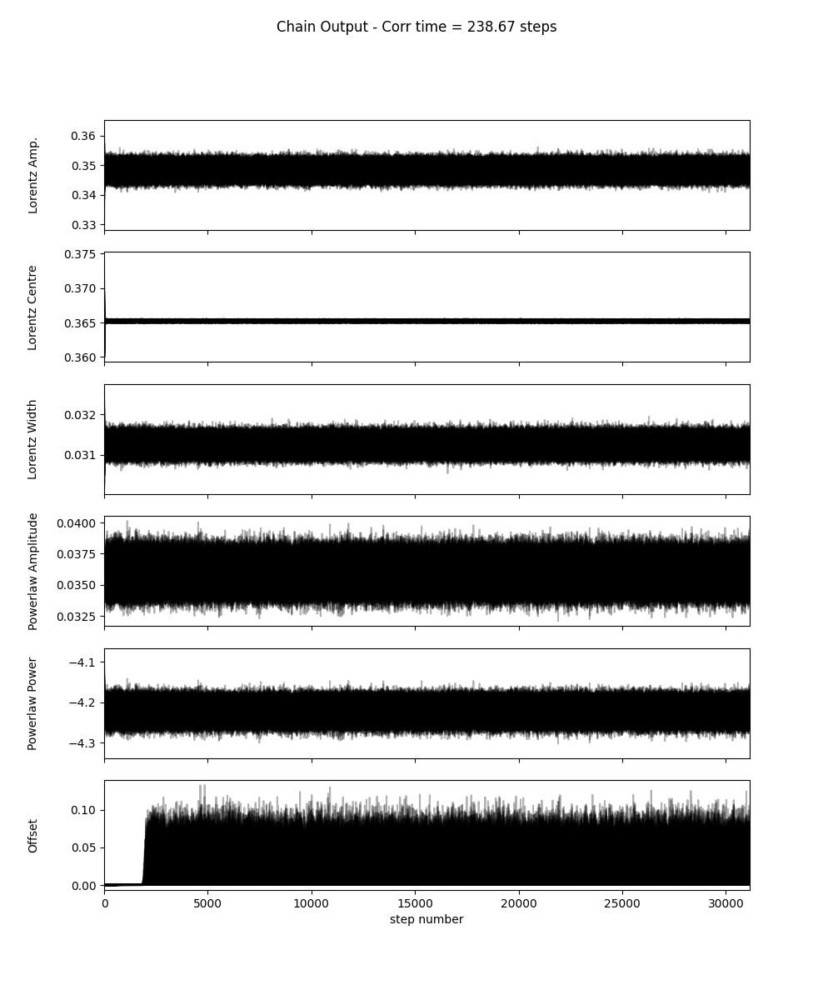

In [20]:
### Display the chain output and estimate where the burn-in period (tau) is.
fig, axes = plt.subplots(len(VERT_LABELS[0]), figsize=(10, 2*len(VERT_LABELS[0])), sharex=True)
MC_samples = sampler.get_chain()
for i in range(ndim):
    ax = axes[i]
    ax.plot(MC_samples[:, :, i], "k", alpha=0.3)
    ax.set_xlim(0, len(MC_samples))
    ax.set_ylabel(VERT_LABELS[0][i])
    ax.yaxis.set_label_coords(-0.1, 0.5)
axes[-1].set_xlabel("step number")
tau_max = np.max(tau)
fig.suptitle(f"Chain Output - Corr time = {tau_max:0.2f} steps")

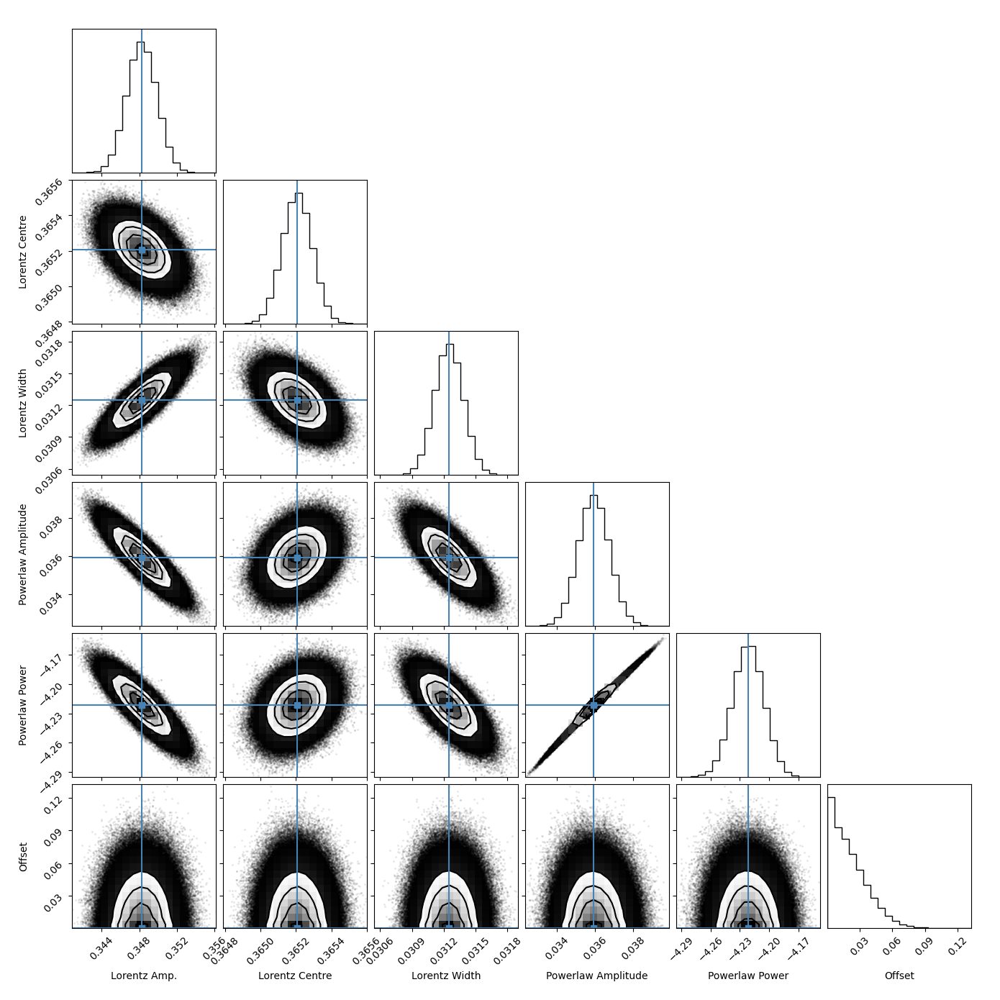

In [23]:
flat_MC_samples = sampler.get_chain(discard=int(tau_max * 3), thin=5, flat=True)
fig = corner.corner(
    flat_MC_samples, labels=VERT_LABELS[0], truths=popt
)

,Lorentz Amp.,Lorentz Centre,Lorentz Width,Powerlaw Amplitude,Powerlaw Power,Offset
Peak #5 Fit,0.348266,0.365207,0.031247,0.035931,-4.221496,8.420973e-20
Peak #5 Error,0.007733,0.000286,0.000625,0.004264,0.084613,3.371414e+06
MCMC Fit,0.348257,0.365207,0.031247,0.035932,-4.221485,1.685708e-02
MCMC LB Error,-0.001584,-0.000084,-0.000133,-0.000797,-0.015921,-1.315173e-02
MCMC UB Error,0.001598,0.000084,0.000134,0.000808,0.015802,2.011551e-02


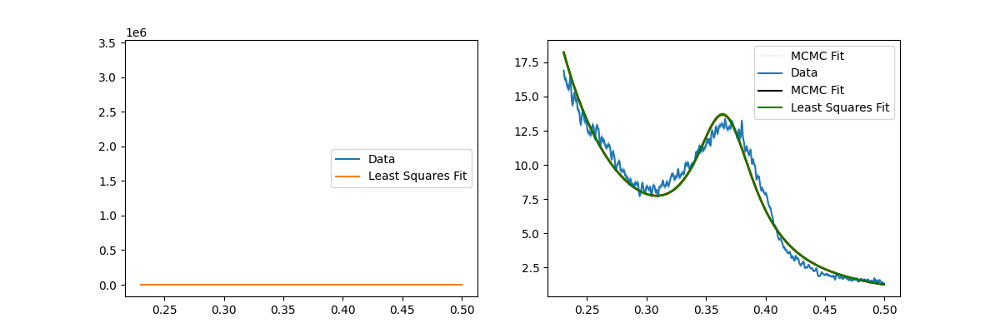

In [22]:
# Plot the result of the Least Squares fit and the MCMC fit
fig, ax = plt.subplots(1, 2, figsize=(12, 4))
q = q0_OOP_TR[idxs]
ax[0].plot(q0_OOP_TR[idxs], I0_OOP_TR[idxs], label="Data")
ax[0].fill_between(q, I0_OOP_TR[idxs] - I0_OOP_err_TR[idxs], I0_OOP_TR[idxs] + I0_OOP_err_TR[idxs], alpha=0.5)
ax[0].plot(q, FIT_REGISTER[0][2](q, *popt), label="Least Squares Fit")
ax[0].fill_between(q, FIT_REGISTER[0][2](q, *popt - np.sqrt(np.diag(pcov))), FIT_REGISTER[0][2](q, *popt + np.sqrt(np.diag(pcov))), alpha=0.1)
ax[0].legend()
                   
# Plot the MCMC fit
MC_samples = sampler.get_chain(discard=200, thin=5, flat=True)
percentiles = [np.percentile(MC_samples[:, i], [16, 50, 84]) for i in range(MC_samples.shape[1])] #Sampling at 1 sigma percentiles
values = [p[1] for p in percentiles]
error_bounds = np.array([[p[0] - p[1], p[2] - p[1]] for p in percentiles])


inds = np.random.randint(len(MC_samples), size=100)
for ind in inds:
    sample = MC_samples[ind]
    ax[1].plot(q, FIT_REGISTER[0][2](q, *sample), "C1", alpha=0.1, label="MCMC Fit" if ind == inds[0] else None)
ax[1].plot(q0_OOP_TR[idxs], I0_OOP_TR[idxs], label="Data")
ax[1].fill_between(q, I0_OOP_TR[idxs] - I0_OOP_err_TR[idxs], I0_OOP_TR[idxs] + I0_OOP_err_TR[idxs], alpha=0.5)
ax[1].plot(q, FIT_REGISTER[0][2](q, *values), 'black', label="MCMC Fit")
ax[1].plot(q, FIT_REGISTER[0][2](q, *popt), label="Least Squares Fit", c='green')
ax[1].legend()


display(pd.DataFrame(
    [popt, np.sqrt(np.diag(pcov)), values, error_bounds[:,0], error_bounds[:,1]],
    columns=VERT_LABELS[0],
    index=[f"Peak #{i} Fit", f"Peak #{i} Error", "MCMC Fit", "MCMC LB Error", "MCMC UB Error"]
))

# Perform reduction and analysis across all samples
### Detector images and consequent line profile reduction
##### Create a plotting function

In [19]:
def generate_aoi_video_figure(geom: SMI_beamline.SMI_geometry, 
                              dataset_minimum:float, 
                              dataset_maximum: float, 
                              ai: float) -> plt.Figure:
    SMI_waxs = geom
    fig = plt.figure(figsize = (4,5), dpi=150)
    gs = fig.add_gridspec(2,2, width_ratios=[1,0.05], height_ratios=[1, 0.05])
    ax = fig.add_subplot(gs[0,0])
    ax_cmap = fig.add_subplot(gs[0,1])
    ax_ai = fig.add_subplot(gs[1,0])

    cmap = plt.cm.get_cmap('terrain')
    norm = mplc.LogNorm(vmin=dataset_minimum, vmax=dataset_maximum, clip=True)
    mp = ax.matshow(SMI_waxs.img_st,
            extent=[SMI_waxs.qp[0], SMI_waxs.qp[-1], SMI_waxs.qz[0], SMI_waxs.qz[-1]],
            cmap = cmap,
            norm=norm
    )
    colorbar = fig.colorbar(mp, cax=ax_cmap, orientation='vertical', location="right", fraction = 0.05)
    colorbar.ax.set_ylabel("Intensity (a.u.)", fontsize=4)
    colorbar.ax.tick_params(axis='both', which='major', labelsize=4)
    ax.axis('off')

    ax2 = ax_ai
    ax2.yaxis.set_ticks([])
    ax2.set_ylim(0,1)
    ax2.set_xscale("log")
    ax2.set_xlim(0.1, 10)
    ax2.tick_params(axis='both', which='major', labelsize=4)
    ax2.plot([ai, ai], [0, 1], 'r')
    ax2.set_xlabel(f"Angle of Incidence     {ai:0.3f}°", loc="left", fontsize=4)

    fig.tight_layout()
    return fig

if "dataset_minimum" in locals():
    generate_aoi_video_figure(SMI_waxs, 1, dataset_maximum, ai)


##### Reduce the lineprofiles

In [20]:
OVERRIDE: bool = False
"""Whether to override the analysis reduction or not."""

plt.ioff()
matplotlib.interactive(False)
with tqdm.notebook.tqdm(total=len(samples), position=0, leave=True, desc="All Samples") as pbar:
    for i, sample in enumerate(samples):
        ## Create the results directory for the sample
        sample_dir = os.path.join(RESULT_DIR, sample)
        if not os.path.isdir(sample_dir):
            os.mkdir(sample_dir)
            
        ## Create the directories for the images and line profiles
        giwaxs_img_dir = os.path.join(sample_dir, "giwaxs_flatfielded_images")
        if not os.path.isdir(giwaxs_img_dir):
            os.mkdir(giwaxs_img_dir)
        line_profiles_dir = os.path.join(sample_dir, "line_profiles")
        if not os.path.isdir(line_profiles_dir):
            os.mkdir(line_profiles_dir)
        
        dataset_maximum = None
        dataset_minimum = None
        with tqdm.notebook.tqdm(total=len(datasets[i]), position=1, leave=False, desc="Finding dataset maximum / minimum") as pbar2:
            for j, fname in enumerate(datasets[i]):
                # Collect the metadata
                en_idx = fname.find('eV_')
                en = float(fname[en_idx-7:en_idx])
                ai_idx = fname.find("_ai")
                ai = float(fname[ai_idx+3:ai_idx+8])
                
                # Update the geometry
                SMI_waxs.alphai = np.deg2rad(ai)
                SMI_waxs.wav = en2wav(en)
                
                # Flatfield / masked normalized data
                SMI_waxs.open_data(RAW_DIR, [fname])
                apply_detector_mask(SMI_waxs)
                apply_flatfield(SMI_waxs, flatfield, flat_percentile=FLATFIELD_PERCENTILE, img_percentile=SAMPLE_PERCENTILE)
                SMI_waxs.stitching_data(interp_factor=3, flag_scale=False)
                
                # Collect the maximum and minimum values
                if dataset_maximum is None:
                    dataset_maximum = np.max(SMI_waxs.img_st)
                else:
                    dataset_maximum = np.max([dataset_maximum, np.max(SMI_waxs.img_st)])
                    
                if dataset_minimum is None:
                    dataset_minimum = np.min(SMI_waxs.img_st[SMI_waxs.img_st > 0])
                else:
                    min_val = np.min(SMI_waxs.img_st[SMI_waxs.img_st > 0])
                    dataset_minimum = np.min([dataset_minimum, min_val])
                pbar2.update(1)
        
        cmap = plt.cm.get_cmap('viridis')
        norm = mplc.LogNorm(vmin=dataset_minimum, vmax=dataset_maximum)
        
        with tqdm.notebook.tqdm(total=len(datasets[i]), position=1, leave=False, desc="Sample dataset") as pbar2:
            # For each file in the sample
            for j, fname in enumerate(datasets[i]):
                # Collect the metadata
                en_idx = fname.find('eV_')
                en = float(fname[en_idx-7:en_idx])
                ai_idx = fname.find("_ai")
                ai = float(fname[ai_idx+3:ai_idx+8])
                
                # Generate paths for the output files
                path_det_img = os.path.join(giwaxs_img_dir, f"{sample}_giwaxs_{en:0.2f}eV_{ai:0.3f}deg.png")
                path_OOP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt")
                path_IP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt")
                path_R = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt")
                path_det_line_profiles_img = os.path.join(sample_dir, f"{sample}_line_profile_angles.png")
                
                # Do not override the files if they "all" exist already. Override partial file sets though.
                if (not OVERRIDE 
                    and os.path.isfile(path_det_img) 
                    and os.path.isfile(path_OOP) 
                    and os.path.isfile(path_IP) 
                    and os.path.isfile(path_R)
                    and (j != 0 or os.path.isfile(path_det_line_profiles_img))):
                    pbar2.total -= 1 # Reduce the total count
                    continue
                
                # Update the geometry
                SMI_waxs.alphai = np.deg2rad(ai)
                SMI_waxs.wav = en2wav(en)
                
                # flatfield / masked normalized data
                SMI_waxs.open_data(RAW_DIR, [fname])
                apply_detector_mask(SMI_waxs)
                apply_flatfield(SMI_waxs, flatfield, flat_percentile=FLATFIELD_PERCENTILE, img_percentile=SAMPLE_PERCENTILE)
                SMI_waxs.stitching_data(interp_factor=3, flag_scale=False)
                
                # Setup a figure and open the file
                fig = generate_aoi_video_figure(SMI_waxs, 1, dataset_maximum, ai)
                fig.savefig(path_det_img)
                ax = fig.get_axes()[0]
                
                if j==0:
                    # Plot the azimuthal and radial angles
                    colors = ['r', 'orange', 'white'][::-1]
                    for angle, width in zip([AZIMUTHAL_INPLANE, AZIMUTHAL_OUTOFPLANE, AZIMUTHAL_RADIAL], [AZIMUTHAL_WIDTH, AZIMUTHAL_WIDTH, RADIAL_WIDTH]):
                        # Generate a set of x points to plot lines of.
                        q_x = np.linspace(0, SMI_waxs.qp[-1], 100)
                        # Calculate the x and y gradients for the lines
                        m1 = np.tan(np.deg2rad(angle - width)) if angle - width != 90 else np.inf
                        m2 = np.tan(np.deg2rad(angle + width)) if angle + width != 90 else np.inf
                        # Calculate the x & y values for the lines
                        q_x1 = q_x if m1 != np.inf else np.zeros(100)
                        q_x2 = q_x if m2 != np.inf else np.zeros(100)
                        y1 = m1 * q_x if m1 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                        y2 = m2 * q_x if m2 != np.inf else np.linspace(0, SMI_waxs.qz[-1], 100)
                        # Plot the lines
                        color = colors.pop()
                        ax.plot(q_x1, y1, color=color, linestyle='-', label=f"{angle} deg")
                        ax.plot(q_x2, y2, color=color, linestyle='-')
                        # If gradient is inf, calculate an alternative fill between
                        if m2 == np.inf:
                                ax.fill_betweenx(y1, q_x1, q_x2, color=color, alpha=0.1)
                        else:
                                ax.fill_between(q_x, y1, y2, color=color, alpha=0.1)
                    ax.set_xlim(*SMI_waxs.qp)
                    ax.set_ylim(*SMI_waxs.qz)
                    ax.legend()
                    fig.savefig(path_det_line_profiles_img, dpi=300)
                plt.close(fig) # Save memory
                
                # Perform the radial/azimuthal averaging
                # In plane and out of plane
                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[90 - (AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH) , 90 - (AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_IP, I0_IP, I0_IP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[90 - (AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH), 90 - (AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_OOP, I0_OOP, I0_OOP_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                # Repeat IP and OOP for the consistency checking
                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[-90+(AZIMUTHAL_INPLANE - AZIMUTHAL_WIDTH), -90+(AZIMUTHAL_INPLANE + AZIMUTHAL_WIDTH)], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_IP2, I0_IP2, I0_IP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[-90+(AZIMUTHAL_OUTOFPLANE - AZIMUTHAL_WIDTH) , -90+(AZIMUTHAL_OUTOFPLANE + AZIMUTHAL_WIDTH)], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_OOP2, I0_OOP2, I0_OOP2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                # Radial averaging
                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[AZIMUTHAL_RADIAL - RADIAL_WIDTH , AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_R, I0_R, I0_R_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err

                # Repeat radial averaging for consistency checking
                SMI_waxs.radial_averaging(radial_range = [0, 8], 
                                        azimuth_range=[180-AZIMUTHAL_RADIAL - RADIAL_WIDTH , 180-AZIMUTHAL_RADIAL + RADIAL_WIDTH], 
                                        npt = NPOINTS_RADIAL_AVE)
                q0_R2, I0_R2, I0_R2_err = SMI_waxs.q_rad, SMI_waxs.I_rad, SMI_waxs.I_rad_err
                
                # Save the line profiles 
                header = ("Main Data\t\tMirror-Y axis Data\t\n" 
                        + "q (Å^-1)\tI (a.u.)\tI_err (a.u.)\tq (Å^-1)\tI (a.u.)\tI_err (a.u.)\n")
                delim = "\t"
                kwargs = {"header": header, "delimiter": delim}
                np.savetxt(path_OOP, np.array([q0_OOP, I0_OOP, I0_OOP_err, q0_OOP2, I0_OOP2, I0_OOP2_err]).T, **kwargs)
                np.savetxt(path_IP, np.array([q0_IP, I0_IP, I0_IP_err, q0_IP2, I0_IP2, I0_IP2_err]).T, **kwargs)
                np.savetxt(path_R, np.array([q0_R, I0_R, I0_R_err, q0_R2, I0_R2, I0_R2_err]).T, **kwargs)
                
                pbar2.update(1)
                plt.close("all")
                # break # Only do the first file for now.
        pbar.update(1)
                

All Samples:   0%|          | 0/417 [00:00<?, ?it/s]

Finding dataset maximum / minimum:   0%|          | 0/139 [00:00<?, ?it/s]

C:\Users\mgebert\AppData\Local\Temp\ipykernel_9152\631492171.py:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis')


Sample dataset:   0%|          | 0/139 [00:00<?, ?it/s]

Finding dataset maximum / minimum:   0%|          | 0/139 [00:00<?, ?it/s]

Sample dataset:   0%|          | 0/139 [00:00<?, ?it/s]

Finding dataset maximum / minimum:   0%|          | 0/139 [00:00<?, ?it/s]

Sample dataset:   0%|          | 0/139 [00:00<?, ?it/s]

##### Render a video

In [21]:
OVERRIDE: bool = True
"""Whether to override the analysis reduction or not."""

import subprocess
with tqdm.notebook.tqdm(total=len(samples), position=0, leave=True, desc="All Samples") as pbar:
    for i, sample in enumerate(samples):
        ## REQUIRES GLOB SUPPORT BY LIBAVFILTER, NOT INCLUDED IN BUILD BINARIES AVAILALBLE ONLINE.
        # img_path_regex = os.path.normpath(os.path.join(giwaxs_img_dir, f"*.png"))
        # ffmpeg_cmd = f'ffmpeg -framerate 30 -pattern_type glob -i "{img_path_regex}" -c:v libx264 -pix_fmt yuv420p "{vid_path_output}"'
        
        ## Results directory for the sample
        sample_dir = os.path.join(RESULT_DIR, sample)    
        ## Images directory
        giwaxs_img_dir = os.path.join(sample_dir, "giwaxs_flatfielded_images")
        img_list = os.listdir(giwaxs_img_dir)
        path_img_list =  os.path.normpath(os.path.join(giwaxs_img_dir, "img_list.txt"))
        with open(path_img_list, 'w') as f:
            for img in img_list:
                if not ".png" in img:
                    continue
                # f.write(f"file '{os.path.normpath(os.path.join(giwaxs_img_dir,img))}' duration 0.033333\n")
                f.write(f"file '{img}'\n outpoint 0.1\n")
        vid_path_output = os.path.normpath(os.path.join(sample_dir, f"{sample}_angle_of_incidence.mp4"))
        
        ## Check if path exists
        if os.path.exists(vid_path_output) and not OVERRIDE:
            print("Video already exists, skipping...")
            pbar.update(1)
        else:
            if os.path.exists(vid_path_output):
                os.remove(vid_path_output)
            ## Video generation
            ffmpeg_cmd = ['ffmpeg', 
                        '-f', 'concat',
                        #   '-safe', '0'
                        '-i', '"' + path_img_list.replace("\\", "/")  + '"',
                        '-framerate', '30',
                        '-c:v', 'libx264',
                        '-shortest',
                        '-r', '30',
                        '-pix_fmt', 'yuv420p',
                        #   '-movflags', 'faststart',
                        #   '-vf', 'format=yuv420p',
                        '"' + vid_path_output + '"']
            a = subprocess.run(args=" ".join(ffmpeg_cmd), capture_output=True)
            # Check for errors!
            display(a.stderr.splitlines())
        pbar.update(1)
        if i != len(samples) - 1:
            display("--------------------------------")


All Samples:   0%|          | 0/3 [00:00<?, ?it/s]

[b'ffmpeg version n7.1-15-g9fbbd924f2-20241024 Copyright (c) 2000-2024 the FFmpeg developers',
 b'  built with gcc 14.2.0 (crosstool-NG 1.26.0.120_4d36f27)',
 b'  configuration: --prefix=/ffbuild/prefix --pkg-config-flags=--static --pkg-config=pkg-config --cross-prefix=x86_64-w64-mingw32- --arch=x86_64 --target-os=mingw32 --enable-gpl --enable-version3 --disable-debug --disable-w32threads --enable-pthreads --enable-iconv --enable-zlib --enable-libfreetype --enable-libfribidi --enable-gmp --enable-libxml2 --enable-lzma --enable-fontconfig --enable-libharfbuzz --enable-libvorbis --enable-opencl --disable-libpulse --enable-libvmaf --disable-libxcb --disable-xlib --enable-amf --enable-libaom --enable-libaribb24 --enable-avisynth --enable-chromaprint --enable-libdav1d --enable-libdavs2 --enable-libdvdread --enable-libdvdnav --disable-libfdk-aac --enable-ffnvcodec --enable-cuda-llvm --enable-frei0r --enable-libgme --enable-libkvazaar --enable-libaribcaption --enable-libass --enable-libbluray

'--------------------------------'

[b'ffmpeg version n7.1-15-g9fbbd924f2-20241024 Copyright (c) 2000-2024 the FFmpeg developers',
 b'  built with gcc 14.2.0 (crosstool-NG 1.26.0.120_4d36f27)',
 b'  configuration: --prefix=/ffbuild/prefix --pkg-config-flags=--static --pkg-config=pkg-config --cross-prefix=x86_64-w64-mingw32- --arch=x86_64 --target-os=mingw32 --enable-gpl --enable-version3 --disable-debug --disable-w32threads --enable-pthreads --enable-iconv --enable-zlib --enable-libfreetype --enable-libfribidi --enable-gmp --enable-libxml2 --enable-lzma --enable-fontconfig --enable-libharfbuzz --enable-libvorbis --enable-opencl --disable-libpulse --enable-libvmaf --disable-libxcb --disable-xlib --enable-amf --enable-libaom --enable-libaribb24 --enable-avisynth --enable-chromaprint --enable-libdav1d --enable-libdavs2 --enable-libdvdread --enable-libdvdnav --disable-libfdk-aac --enable-ffnvcodec --enable-cuda-llvm --enable-frei0r --enable-libgme --enable-libkvazaar --enable-libaribcaption --enable-libass --enable-libbluray

'--------------------------------'

[b'ffmpeg version n7.1-15-g9fbbd924f2-20241024 Copyright (c) 2000-2024 the FFmpeg developers',
 b'  built with gcc 14.2.0 (crosstool-NG 1.26.0.120_4d36f27)',
 b'  configuration: --prefix=/ffbuild/prefix --pkg-config-flags=--static --pkg-config=pkg-config --cross-prefix=x86_64-w64-mingw32- --arch=x86_64 --target-os=mingw32 --enable-gpl --enable-version3 --disable-debug --disable-w32threads --enable-pthreads --enable-iconv --enable-zlib --enable-libfreetype --enable-libfribidi --enable-gmp --enable-libxml2 --enable-lzma --enable-fontconfig --enable-libharfbuzz --enable-libvorbis --enable-opencl --disable-libpulse --enable-libvmaf --disable-libxcb --disable-xlib --enable-amf --enable-libaom --enable-libaribb24 --enable-avisynth --enable-chromaprint --enable-libdav1d --enable-libdavs2 --enable-libdvdread --enable-libdvdnav --disable-libfdk-aac --enable-ffnvcodec --enable-cuda-llvm --enable-frei0r --enable-libgme --enable-libkvazaar --enable-libaribcaption --enable-libass --enable-libbluray

##### Show the video to check for any inconsistencies

In [23]:
from IPython.display import Video
for i, sample in enumerate(samples):
    ## Results directory for the sample
    sample_dir = os.path.join(RESULT_DIR, sample)    
    vid_path_output = os.path.normpath(os.path.join(sample_dir, f"{sample}_angle_of_incidence.mp4"))
    v = Video(vid_path_output, embed=True)
    display(v)

### Perform Fitting and MC Sampling
##### Reset magic and matplotlib to avoid memory leaks

In [24]:
# Ipython causes memory leaks when using interactive matplotlib and generating lots of graphs.
# https://github.com/ipython/ipython/issues/7270#issuecomment-355276432
%matplotlib inline
matplotlib.interactive(False)
plt.ioff()
plt.close("all")

##### Least squares fitting

In [44]:
OVERRIDE: bool = False
"""Whether to override the analysis reduction or not."""

USE_GUESS_FIRST: bool = True
"""Whether to use the initial guess for the least squares fit instead of the previous fit result."""

dataset_fits: list[list[np.ndarray]] = [[np.zeros(
                                            (len(datasets[i]), 1 + len(FIT_REGISTER[j][3]) * 2)
                                        )
                                        for j in range(len(FIT_REGISTER))]
                                        for i in range(len(samples))]
"""For each sample, for each peak, the parameters: the angle of incidence and a set of the least squares popt values and errors"""

dataset_beamstop_area: list[np.ndarray] = [np.zeros((len(datasets[i]), 3)) for i in range(len(samples))]
"""For each sample, the angle of incidence, the beamstop area and error"""

with tqdm.notebook.tqdm(total=len(samples), position=2, leave=True, desc="Sample") as pbar:
    for i, sample in enumerate(samples):
        # Setup sample dependent variables
        sample_fits = dataset_fits[i]
        
        # Create the results directory for the sample
        sample_dir = os.path.join(RESULT_DIR, sample)
        if not os.path.isdir(sample_dir):
            os.mkdir(sample_dir)
        fits_img_dir = os.path.join(sample_dir, "ls_fit_images")
        if not os.path.isdir(fits_img_dir):
            os.mkdir(fits_img_dir)
            
        # Setup files to store results as they are generated
        paths_ls_fits: list[str] = [os.path.join(sample_dir, f"{sample}-{d}-{q0}_to_{q1}-ls_fits.txt") for d, (q0,q1), _, _, _, _ in FIT_REGISTER]
        paths_beamstop_area: str = os.path.join(sample_dir, f"{sample}-beamstop_integrated-area.txt")
        
        # First line header
        header_ls = [("\t".join(["Angle of Incidence"] + ["Fit Params"]*len(labels) + ["Fit Errors"]*len(labels) + ["Filename"])) 
                    + ("\n" + "\t".join(["Angle of Incidence"] + labels + [label + "_unc" for label in labels] + ["Filename"]))
                    for _, _, _, _, _, labels in FIT_REGISTER ]
        header_beamstop = "Angle of Incidence\tBeamstop Area\tBeamstop Area Error\tFilename"
        
        # Load the angles of incidence already processed    
        prev_ls_datasets: list[dict[str, np.ndarray]] = [{} for _ in range(len(FIT_REGISTER))]
        """For each peak, a dictionary containing the previous least squares fits for each file."""
        prev_beamstop_area: dict[str, np.ndarray] = {}
        """A dictionary containing the previous beamstop area for each file."""
        
        # Iterate over each peak
        with tqdm.notebook.tqdm(total=len(datasets[i]), position=1, leave=False, desc="Sample Scans") as pbar2:
            for j in range(len(FIT_REGISTER)):
                # Get the paths for the peak fit files
                path_ls_fits = paths_ls_fits[j]
                # Check if the file exists already, and load previous/existing data.
                if os.path.isfile(path_ls_fits) and not OVERRIDE:
                    # Ignore the UserWarning from numpy for empty files - taken care of below.
                    with warnings.catch_warnings():
                        warnings.simplefilter("ignore", category=UserWarning)
                        prev_ls_fits = np.loadtxt(path_ls_fits, delimiter="\t", skiprows=2, dtype=str)
                    
                    if len(prev_ls_fits) == 0:
                        # No data in the file, skip loading.
                        continue
                    if len(prev_ls_fits.shape) == 1:
                        prev_ls_fits = prev_ls_fits.reshape(1, -1)
                    # Collect common fits and load into memory
                    for fname in prev_ls_fits[:, -1]:
                        # Check if the file has been MCMC fitted as well, and is loadable data:
                        if fname in datasets[i]:
                            idx = np.where(prev_ls_fits[:, -1] == fname)[0][0]
                            prev_ls_datasets[j][fname] = prev_ls_fits[idx, :-1].astype(float)
                    print(f"Loaded {len(prev_ls_datasets[j])} previous fits for peak {j}.")
            
            # Load the beamstop area data
            if os.path.isfile(paths_beamstop_area) and not OVERRIDE:
                # Ignore the UserWarning from numpy for empty files - taken care of below.
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore", category=UserWarning)
                    prev_beamstop_data = np.loadtxt(paths_beamstop_area, delimiter="\t", skiprows=1, dtype=str)
                    
                if len(prev_beamstop_data) == 0:
                    # No data in the file, skip loading.
                    pass
                else:
                    if len(prev_beamstop_data.shape) == 1:
                        prev_beamstop_data = prev_beamstop_data.reshape(1, -1)
                    for fname in prev_beamstop_data[:, -1]:
                        if fname in datasets[i]:
                            idx = np.where(prev_beamstop_data[:, -1] == fname)[0][0]
                            prev_beamstop_area[fname] = prev_beamstop_data[idx, :-1].astype(float)
                    print(f"Loaded {len(prev_beamstop_area)} previous beamstop areas.")
            
            # Begin writing the files
            open_ls_fits = [open(paths_ls_fits[j], "w") for j in range(len(FIT_REGISTER))]
            open_beamstop_area = open(paths_beamstop_area, "w")
            try: # Ensure the files are closed
                # Write the headers and previous data
                for j in range(len(FIT_REGISTER)):
                    open_ls_fits[j].write(header_ls[j])
                    for fname in prev_ls_datasets[j].keys():
                        open_ls_fits[j].write("\n" + "\t".join([str(val) for val in prev_ls_datasets[j][fname]] + [fname]))
                
                # Write the beamstop area header and previous data
                open_beamstop_area.write(header_beamstop)
                for fname in prev_beamstop_area.keys():
                    open_beamstop_area.write("\n" + "\t".join([str(val) for val in prev_beamstop_area[fname]] + [fname]))
                        
                # Loop over all files in the sample dataset
                for j, fname in enumerate(datasets[i]):
                    # Check if the file has already been processed
                    #-----------------------------------------------
                    if not OVERRIDE and all(
                        [fname in prev_ls_dataset.keys()
                        for prev_ls_dataset in prev_ls_datasets]
                        ):
                        print(f"File data already exists for all peaks, skipping `{fname}`.")
                        # Reload the existing data and skip.
                        for k in range(len(FIT_REGISTER)):
                            dataset_fits[i][k][j,:] = prev_ls_datasets[k][fname]
                        if fname in prev_beamstop_area:
                            dataset_beamstop_area[i][j,:] = prev_beamstop_area[fname]
                        pbar.total -= 1
                        pbar2.total -= 1
                        continue
                    
                    ### Otherwise, load the data and perform the fits
                    # Collect the metadata
                    en_idx = fname.find('eV_')
                    en = float(fname[en_idx-7:en_idx])
                    ai_idx = fname.find("_ai")
                    ai = float(fname[ai_idx+3:ai_idx+8])
                    
                    # Setup the file dependent output paths
                    path_det_line_profiles_img = os.path.join(sample_dir, f"{sample}_line_profile_angles.png")
                    
                    # Collect the line profiles from disk
                    line_profiles_dir = os.path.join(sample_dir, "line_profiles")
                    if not os.path.isdir(line_profiles_dir):
                        os.mkdir(line_profiles_dir)
                    path_OOP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt")
                    path_IP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt")
                    path_R = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt")
                    
                    q0_OOP, I0_OOP, I0_OOP_err, _, _, _ = np.loadtxt(path_OOP, delimiter="\t", unpack=True, skiprows=2)
                    q0_IP, I0_IP, I0_IP_err, _, _, _ = np.loadtxt(path_IP, delimiter="\t", unpack=True, skiprows=2)
                    q0_R, I0_R, I0_R_err, _, _, _ = np.loadtxt(path_R, delimiter="\t", unpack=True, skiprows=2)
                    
                    # Beamstop region of interest:
                    BS_idx = np.where((q0_OOP > VERT_BEAMSTOP[0]) & (q0_OOP < VERT_BEAMSTOP[1]))
                    q0_BS, I0_BS, I0_BS_err = q0_OOP[BS_idx], I0_OOP[BS_idx], np.sqrt(I0_OOP[BS_idx])
                    beamstop_data = [ai, np.trapezoid(I0_BS, q0_BS), np.trapezoid(np.sqrt(I0_BS), q0_BS)]
                    dataset_beamstop_area[i][j, :] = beamstop_data
                    open_beamstop_area.write("\n" + "\t".join([str(param) for param in (beamstop_data + [fname])]))
                    
                    # Perform a fit to the data for each listed peak.
                    for k, (d, peak, fit_fn, guess, bounds, labels) in enumerate(FIT_REGISTER):
                        # Setup the data
                        if d == "OOP":
                            q0, I0, I0_err = q0_OOP, I0_OOP, I0_OOP_err
                        elif d == "IP":
                            q0, I0, I0_err = q0_IP, I0_IP, I0_IP_err
                        elif d == "RAD":
                            q0, I0, I0_err = q0_R, I0_R, I0_R_err
                        
                        # Remove rows with NaN or zero values and collect the fit subset data
                        idx = np.where((~np.isnan(I0)) & (I0 != 0) & (q0 > peak[0]) & (q0 < peak[1]))
                        q, I, I_err = q0[idx], I0[idx], I0_err[idx]
                            
                        # Define the output paths
                        fits_img_peak_dir = os.path.join(fits_img_dir, f"{d}-{peak[0]}_to_{peak[1]}_perÅ")
                        if not os.path.isdir(fits_img_peak_dir):
                            os.mkdir(fits_img_peak_dir)
                        path_fit_img = os.path.join(fits_img_peak_dir, f"{sample}_fit-{d}-peak_{peak[0]}-{peak[1]}_perÅ-{en:0.2f}eV-{ai:0.3f}deg.png")
                        
                        # Perform a least squres fit
                        if USE_GUESS_FIRST:
                            try: 
                                popt, pcov = curve_fit(fit_fn, q, I, sigma=I_err, p0=guess, maxfev=100000, bounds=bounds)
                            except RuntimeError as e:
                                if j > 0:
                                    print("Re-attempting fit again with previous fit instead of initial guess.")
                                    popt, pcov = curve_fit(fit_fn, q, I, sigma=I_err, p0=dataset_fits[i][k][j-1, 1:1+len(guess)], maxfev=100000, bounds=bounds)
                                else:
                                    raise e
                        else:
                            try:
                                if j > 0:
                                    popt, pcov = curve_fit(fit_fn, q, I, sigma=I_err, p0=dataset_fits[i][k][j-1, 1:1+len(guess)], maxfev=100000, bounds=bounds)
                                else:
                                    popt, pcov = curve_fit(fit_fn, q, I, sigma=I_err, p0=guess, maxfev=100000, bounds=bounds)
                            except RuntimeError as e:
                                print("Re-attempting fit again with initial guess instead of previous fit.")
                                popt, pcov = curve_fit(fit_fn, q, I, sigma=I_err, p0=guess, maxfev=100000, bounds=bounds)
                        data_line = np.r_[[ai], popt, np.sqrt(np.diag(pcov))]
                        dataset_fits[i][k][j, :] = data_line
                        open_ls_fits[k].write("\n" + "\t".join([str(val) for val in data_line] + [fname])) #Save the data

                        # Plot the fit
                        fig, ax = plt.subplots(1, 1, figsize=(5, 4))
                        ax.plot(q, I, label="Data")
                        ax.fill_between(q, I - I_err, I + I_err, alpha=0.2)
                        ax.plot(q, fit_fn(q, *popt), label="Least Squares Fit")
                        # ax.fill_between(q, fit_fn(q, *popt - np.sqrt(np.diag(pcov))), fit_fn(q, *popt + np.sqrt(np.diag(pcov))), alpha=0.1)
                        ax.set_ylim(0, 1.1 * np.max(I))
                        ax.set_title(f"{sample}\n{en} eV - {ai} deg - Peak {peak[0]}-{peak[1]}")
                        fig.savefig(path_fit_img)
                        fig.tight_layout()
                        plt.close() # Save memory
                    plt.close("all")
                    pbar2.update(1)
                    
                # Close the files
                for f1 in open_ls_fits:
                    f1.close()
                open_beamstop_area.close()
                
                # Generate final graphics for the angle of incidence fits to each peak.
                #-----------------------------------------------------------------------
                for k, (d, peak, fit_fn, guess, bounds, labels) in enumerate(FIT_REGISTER):
                    path_ls_summary = os.path.join(sample_dir, f"{sample}_ls_fits_summary.png")
                
                    # Load the data
                    ls_fits = dataset_fits[i][k]
                    # Re-index the data
                    angles = ls_fits[:, 0]
                    ls_popt = ls_fits[:, 1:1+len(labels)]
                    ls_errors = ls_fits[:, 1+len(labels):]
                    
                    # Plot the LS data
                    fig, ax = plt.subplots(len(labels), 1, figsize=(8, 2*len(labels)))
                    for z in range(len(labels)):
                        ax[z].plot(angles, ls_popt[:, z], label=labels[z])
                        ax[z].fill_between(angles, ls_popt[:, z] - ls_errors[:, z], ls_popt[:, z] + ls_errors[:, z], alpha=0.1)
                        ax[z].set_ylabel(labels[z])
                    fig.suptitle(f"{sample}\n{d} Peak {peak[0]:0.2f} to {peak[1]:0.2f} - Least Squares Fit Summary")
                    fig.savefig(path_ls_summary)
                    fig.tight_layout()
                    plt.close()
                    
            except Exception as e:
                print(f"Error processing {sample}: {e}")
                # Close the files
                for f1 in open_ls_fits:
                    f1.close()
                open_beamstop_area.close()
                raise e
        pbar.update(1)

Sample:   0%|          | 0/3 [00:00<?, ?it/s]

Sample Scans:   0%|          | 0/139 [00:00<?, ?it/s]

Loaded 139 previous fits for peak 0.
Loaded 139 previous beamstop areas.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.200_wa0_bpm119.668_id780134_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.220_wa0_bpm119.659_id780135_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.240_wa0_bpm119.492_id780136_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.260_wa0_bpm119.515_id780137_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.280_wa0_bpm119.496_id780138_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_02_a_2450.00eV_ai0.300_wa0_bpm119.622_id780139_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentangl

Sample Scans:   0%|          | 0/139 [00:00<?, ?it/s]

Loaded 139 previous beamstop areas.


C:\Users\mgebert\AppData\Local\Temp\ipykernel_9152\385638817.py:1: RuntimeWarning: overflow encountered in power
  power_law = lambda x, a=1, b=-1, c=0: a * (x-c)**b
C:\Users\mgebert\AppData\Local\Temp\ipykernel_9152\385638817.py:1: RuntimeWarning: overflow encountered in multiply
  power_law = lambda x, a=1, b=-1, c=0: a * (x-c)**b
C:\Users\mgebert\AppData\Local\Temp\ipykernel_9152\385638817.py:40: RuntimeWarning: overflow encountered in square
  fit_fn_lor = lambda x, a,b,c,d,e,f: np.sqrt((lorentz(x,a,b,c) + power_law(x,d,e))**2 + f**2)


Sample Scans:   0%|          | 0/139 [00:00<?, ?it/s]

Loaded 139 previous fits for peak 0.
Loaded 139 previous beamstop areas.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.200_wa0_bpm120.034_id781441_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.220_wa0_bpm120.139_id781442_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.240_wa0_bpm120.087_id781443_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.260_wa0_bpm119.978_id781444_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.280_wa0_bpm119.947_id781445_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentanglescan_A1_04_a_2450.00eV_ai0.300_wa0_bpm119.962_id781446_000000_WAXS.tif`.
File data already exists for all peaks, skipping `CM_wideincidentangl

In [23]:
# Additional close command in case files are still open
for f1 in open_ls_fits:
    f1.close()
open_beamstop_area.close()

In [26]:
MCMC_SAMPLING : bool = False
"""Whether to use MCMC sampling to fit the data or not"""
N: int = 200
"""The number of walkers to use in the MCMC sampling"""
M = 1000
"""The default number of steps to use in the MCMC sampling"""

dataset_MC_fits: list[list[np.ndarray]] = [[np.zeros(
                                                (len(datasets[i]), 1 + len(FIT_REGISTER[j][3]) * 3)
                                            )
                                            for j in range(len(FIT_REGISTER))]
                                            for i in range(len(samples))]
"""For each sample, for each peak, the parameters: the angle of incidence and a set of the MCMC opt values and lb/ub"""


OVERRIDE: bool = False
"""Whether to override the analysis reduction or not."""

with tqdm.notebook.tqdm(total=np.sum([len(datasets[i]) for i in range(len(datasets))]), position=2, leave=True, desc="Sample") as pbar:
    for i, sample in enumerate(samples):
        # Setup sample dependent variables
        sample_fits = dataset_fits[i]
        sample_MC_fits = dataset_MC_fits[i]
        
        # Create the results directory for the sample
        sample_dir = os.path.join(RESULT_DIR, sample)
        if not os.path.isdir(sample_dir):
            os.mkdir(sample_dir)
        mcmc_img_dir = os.path.join(sample_dir, "mcmc_fit_images")
        if not os.path.isdir(mcmc_img_dir):
            os.mkdir(mcmc_img_dir)
            
        # Setup files to store results as they are generated
        paths_mcmc_fits: list[str] = [os.path.join(sample_dir, f"{sample}-{d}-{q0}_to_{q1}-mcmc_fits.txt") for d, (q0,q1), _, _, _, _ in FIT_REGISTER]
        
        # First line header
        header_mcmc = [("\t".join(["Angle of Incidence"] + ["MC Fit Params"]*len(labels) + ["MC LB Errors"]*len(labels) + ["MC UB Errors"]*len(labels) + ["Filename"]))
                    + ("\n" + "\t".join(["Angle of Incidence"] + labels + [label + "_unc_lb" for label in labels] + [label + "_unc_ub" for label in labels] + ["Filename"]))
                    for _, _, _, _, _, labels in FIT_REGISTER]
                
        # Load the angles of incidence already processed    
        prev_mcmc_datasets: list[dict[str, np.ndarray]] = [{} for _ in range(len(FIT_REGISTER))]
        """For each peak, a dictionary containing the previous mcmc fits for each file."""
        
        # Iterate over each peak
        with tqdm.notebook.tqdm(total=len(datasets[i]), position=1, leave=False, desc="Sample Scans") as pbar2:
            for j in range(len(FIT_REGISTER)):
                # Get the paths for the peak fit files
                path_mcmc_fits = paths_mcmc_fits[j]
                # Check if the file exists already, and load previous/existing data.
                if os.path.isfile(path_mcmc_fits) and not OVERRIDE:
                    # Ignore the UserWarning from numpy for empty files - taken care of below.
                    with warnings.catch_warnings():
                        warnings.simplefilter("ignore", category=UserWarning)
                        prev_mcmc_fits = np.loadtxt(path_mcmc_fits, delimiter="\t", skiprows=2, dtype=str)
                    
                    if len(prev_mcmc_fits) == 0:
                        # No data in the file, skip loading.
                        continue
                    if len(prev_mcmc_fits.shape) == 1:
                        prev_mcmc_fits = prev_mcmc_fits.reshape(1, -1)
                    # Collect common fits and load into memory
                    for fname in prev_mcmc_fits[:, -1]:
                        # Check if the file has been MCMC fitted as well, and is loadable data:
                        if fname in datasets[i]:
                            idx = np.where(prev_mcmc_fits[:, -1] == fname)[0][0]
                            prev_mcmc_datasets[j][fname] = prev_mcmc_fits[idx, :-1].astype(float)
                    print(f"Loaded {len(prev_mcmc_datasets[j])} previous fits for peak {j}.")
            
            
            # Begin writing the files
            open_mcmc_fits = [open(paths_mcmc_fits[j], "w") for j in range(len(FIT_REGISTER))]
            try:
                # Write the headers and previous data
                for j in range(len(FIT_REGISTER)):
                    open_mcmc_fits[j].write(header_mcmc[j])
                    for fname in prev_mcmc_datasets[j].keys():
                        open_mcmc_fits[j].write("\n" + "\t".join([str(val) for val in prev_mcmc_datasets[j][fname]] + [fname]))
                        
                # Loop over all files in the sample dataset
                for j, fname in enumerate(datasets[i]):
                    # Check if the file has already been processed
                    #-----------------------------------------------
                    if not OVERRIDE and all(
                        [fname in prev_mcmc_dataset.keys()
                        for prev_mcmc_dataset in prev_mcmc_datasets]
                        ):
                        print(f"File data already exists for all peaks, skipping `{fname}`.")
                        # Reload the existing data and skip.
                        for k in range(len(FIT_REGISTER)):
                            dataset_MC_fits[i][k][j,:] = prev_mcmc_datasets[k][fname]
                        
                        pbar.total -= 1
                        pbar2.total -= 1
                        continue
                    
                    ### Otherwise, load the data and perform the fits
                    # Collect the metadata
                    en_idx = fname.find('eV_')
                    en = float(fname[en_idx-7:en_idx])
                    ai_idx = fname.find("_ai")
                    ai = float(fname[ai_idx+3:ai_idx+8])
                    
                    # Collect the line profiles from disk
                    line_profiles_dir = os.path.join(sample_dir, "line_profiles")
                    path_OOP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_OOP.txt")
                    path_IP = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_IP.txt")
                    path_R = os.path.join(line_profiles_dir, f"{sample}_line_profile_{en:0.2f}eV_{ai:0.3f}deg_R.txt")
                    
                    q0_OOP, I0_OOP, I0_OOP_err, _, _, _ = np.loadtxt(path_OOP, delimiter="\t", unpack=True, skiprows=2)
                    q0_IP, I0_IP, I0_IP_err, _, _, _ = np.loadtxt(path_IP, delimiter="\t", unpack=True, skiprows=2)
                    q0_R, I0_R, I0_R_err, _, _, _ = np.loadtxt(path_R, delimiter="\t", unpack=True, skiprows=2)
                    
                    # Perform a fit to the data for each listed peak.
                    for k, (d, peak, fit_fn, guess, bounds, labels) in enumerate(FIT_REGISTER):
                        # Setup the data
                        if d == "OOP":
                            q0, I0, I0_err = q0_OOP, I0_OOP, I0_OOP_err
                        elif d == "IP":
                            q0, I0, I0_err = q0_IP, I0_IP, I0_IP_err
                        elif d == "RAD":
                            q0, I0, I0_err = q0_R, I0_R, I0_R_err
                        
                        # Remove rows with NaN or zero values and collect the fit subset data
                        idx = np.where((~np.isnan(I0)) & (I0 != 0) & (q0 > peak[0]) & (q0 < peak[1]))
                        q, I, I_err = q0[idx], I0[idx], I0_err[idx]
                            
                        # Define the output paths
                        mcmc_img_peak_dir = os.path.join(mcmc_img_dir, f"{d}-{peak[0]}_to_{peak[1]}_perÅ")
                        if not os.path.isdir(mcmc_img_peak_dir):
                            os.mkdir(mcmc_img_peak_dir)
                        path_mc_chain = os.path.join(mcmc_img_peak_dir, f"mcmc_chain-{sample}-peak_{peak[0]}-{peak[1]}_perÅ-{en:0.2f}eV-{ai:0.3f}deg-{d}.png")
                        path_mc_corner_plot = os.path.join(mcmc_img_peak_dir, f"corner_plot-{sample}-peak_{peak[0]}-{peak[1]}_perÅ-{en:0.2f}eV-{ai:0.3f}deg-{d}.png")
                        
                        # Obtain the least squres fit
                        popt = dataset_fits[i][k][j, 1:1+len(guess)]

                        # # Plot the fit
                        # fig, ax = plt.subplots(1, 1, figsize=(4, 2.5))
                        # ax.plot(q, I, label="Data")
                        # ax.fill_between(q, I - I_err, I + I_err, alpha=0.2)
                        # ax.plot(q, fit_fn(q, *popt), label="Least Squares Fit")
                        # # ax.fill_between(q, fit_fn(q, *popt - np.sqrt(np.diag(pcov))), fit_fn(q, *popt + np.sqrt(np.diag(pcov))), alpha=0.1)
                        # ax.set_ylim(0, 1.1 * np.max(I))
                        # ax.set_title(f"{sample}\n{en} eV - {ai} deg - Peak {peak[0]}-{peak[1]}")
                        # fig.savefig(path_fit_img)
                        # plt.close() # Save memory
                        
                        # Create the MCMC fitter
                        init_position = (popt * np.ones((N, len(popt))) # Add some small random magnitude variance on each parameter.
                                        * (1 + (1.0e-2 * np.random.randn(N, len(popt)) - 5.0e-3))) 
                        for b in range(len(bounds[0])):
                            lb, ub = bounds[0][b], bounds[1][b]
                            if lb is not None:
                                init_position[:,b] = np.clip(init_position[:,b], lb, np.inf)
                            if ub is not None:
                                init_position[:,b] = np.clip(init_position[:,b], -np.inf, ub)
                                
                        nwalkers, ndim = init_position.shape
                        sampler = emcee.EnsembleSampler(
                            nwalkers, ndim, LOG_PROBABILITY_FNS[k], args=(q, I, I_err, LOG_PRIOR_FNS[k], LOG_LIKELIHOOD_FNS[k])
                        )
                        # Run for M steps
                        sampler.run_mcmc(init_position, M, progress=True, progress_kwargs={"leave": False, "position":0})
                        # Check the autocorrelation time, and run for more steps if necessary.
                        max_tau = None
                        sample_attempts = 1
                        while max_tau is None:
                            try:
                                tau = sampler.get_autocorr_time()
                                max_tau = np.nanmax(tau)
                            except emcee.autocorr.AutocorrError as e:
                                if np.isnan(e.tau).all():
                                    print("Nan tau, running for 1000 more steps.")
                                    sampler.run_mcmc(None, 1000, progress=False, progress_kwargs={"leave": False, "position":0})
                                else:
                                    tau_estimate = int(np.nanmax(e.tau))
                                    if tau_estimate * 50 < 150000:
                                        print(f"Estimated max tau: {tau_estimate}, running for {50*tau_estimate} more steps.")
                                        sampler.run_mcmc(None, tau_estimate * 50, progress=False, progress_kwargs={"leave": False, "position":0})
                                    elif len(sampler.get_chain()) > 2 * tau_estimate:
                                        max_tau = tau_estimate
                                    else:
                                        print("Tau estimate unreasonably large.")
                                        sample_attempts = 11
                            sample_attempts += 1
                            if sample_attempts > 10: # Break if the sample attempts exceed 10
                                break
                            
                        # Skip the MCMC fit if the sample attempts exceed 10.
                        if sample_attempts > 10:
                            print("Skipping MCMC fit, using nans.")
                            dataset_MC_fits[i][k][j,:] = np.full((1 + len(labels)*3, ), np.nan)
                            pbar.update(1)
                            pbar2.update(1)
                            continue
                        
                        # Create a default max_tau value if it is not found.
                        if np.isnan(max_tau):
                            max_tau = 0
                            
                        # Get the samples and discard some for the burn-in period
                        MC_samples = sampler.get_chain()
                        flat_MC_samples = sampler.get_chain(discard=int(max_tau * 3), thin=5, flat=True)

                        # Save the MCMC fit results
                        percentiles = [np.percentile(MC_samples[:, :, z], [16, 50, 84]) for z in range(MC_samples.shape[2])] #Sampling at 1 sigma percentiles
                        values = np.array([p[1] for p in percentiles])
                        gauss_error = np.array([[p[0] - p[1], p[2] - p[1]] for p in percentiles])
                        
                        mc_data_line = np.r_[[ai], values, gauss_error[:,0], gauss_error[:,1]]
                        # Save the MC data to the open file
                        open_mcmc_fits[k].write("\n" + "\t".join([str(val) for val in mc_data_line] + [fname]))
                        dataset_MC_fits[i][k][j, :] = mc_data_line
                        
                        # Plot the chain output
                        fig, axes = plt.subplots(len(labels), figsize=(10, 2*len(labels)), sharex=True)
                        for z in range(ndim):
                            ax = axes[z]
                            ax.plot(MC_samples[:, :, z], "k", alpha=0.3)
                            ax.set_xlim(0, len(MC_samples))
                            ax.set_ylabel(labels[z])
                            ax.yaxis.set_label_coords(-0.1, 0.5)
                        axes[-1].set_xlabel("step number")
                        fig.suptitle(f"Chain Output - Corr time = {max_tau:0.2f} steps")
                        fig.savefig(path_mc_chain)
                        plt.close()
                    
                        # Create a corner plot        
                        fig = corner.corner(
                            flat_MC_samples, labels=labels, truths=popt
                        )
                        fig.savefig(path_mc_corner_plot)
                        plt.close()
                    plt.close("all")
                    
                    pbar.update(1)
                    pbar2.update(1)
                    
                # Close the files
                for f1, f2 in zip(open_ls_fits, open_mcmc_fits):
                    f1.close()
                    f2.close()
                open_beamstop_area.close()
                
                # Generate final graphics for the angle of incidence fits to each peak.
                #-----------------------------------------------------------------------
                for k, (d, peak, fit_fn, guess, bounds, labels) in enumerate(FIT_REGISTER):
                    path_ls_summary = os.path.join(sample_dir, f"{sample}-peak_{peak[0]}-{peak[1]}_perÅ-ls_fits_summary.png")
                    path_mcmc_summary = os.path.join(sample_dir, f"{sample}-peak_{peak[0]}-{peak[1]}_perÅ-mcmc_fits_summary.png")
                    path_overlap_summary = os.path.join(sample_dir, f"{sample}-peak_{peak[0]}-{peak[1]}_perÅ-overlap_fits_summary.png")
                
                    # Load the data
                    ls_fits = dataset_fits[i][k]
                    MC_fits = dataset_MC_fits[i][k]
                    # Re-index the data
                    angles = ls_fits[:, 0]
                    ls_popt = ls_fits[:, 1:1+len(labels)]
                    ls_errors = ls_fits[:, 1+len(labels):]
                    MC_popt = MC_fits[:, 1:1+len(labels)]
                    MC_lb_errors = MC_fits[:, 1+len(labels):1+2*len(labels)]
                    MC_ub_errors = MC_fits[:, 1+2*len(labels):]
                    
                    # Plot the MCMC data
                    fig, ax = plt.subplots(len(labels), 1, figsize=(8, 2*len(labels)))
                    for z in range(len(labels)):
                        ax[z].plot(angles, MC_popt[:, z], label=labels[z])
                        ax[z].fill_between(angles, MC_popt[:, z] - MC_lb_errors[:, z], MC_popt[:, z] + MC_ub_errors[:, z], alpha=0.1)
                        ax[z].set_ylabel(labels[z])
                    fig.suptitle(f"{sample}\n{d} Peak {peak[0]:0.2f} to {peak[1]:0.2f} - MCMC Fit Summary")
                    fig.savefig(path_mcmc_summary)
                    plt.close()
                    
                    # Plot the overlap data
                    fig, ax = plt.subplots(len(labels), 1, figsize=(8, 2*len(labels)))
                    for z in range(len(labels)):
                        ax[z].plot(angles, ls_popt[:, z], label="Least Squares Fit")
                        ax[z].fill_between(angles, ls_popt[:, z] - ls_errors[:, z], ls_popt[:, z] + ls_errors[:, z], alpha=0.1)
                        ax[z].plot(angles, MC_popt[:, z], label="MCMC Fit")
                        ax[z].fill_between(angles, MC_popt[:, z] - MC_lb_errors[:, z], MC_popt[:, z] + MC_ub_errors[:, z], alpha=0.1)
                        ax[z].set_ylabel(labels[z])
                        ax[z].legend()
                    fig.suptitle(f"{sample}\n{d} Peak {peak[0]:0.2f} to {peak[1]:0.2f} - MCMC/LS Fit Overlap Summary")
                    fig.savefig(path_overlap_summary)
                    plt.close()
            except Exception as e:
                print(f"Error processing {sample}: {e}")
                # Close the files
                for f2 in open_mcmc_fits:
                    f2.close()
                raise e

Sample:   0%|          | 0/417 [00:00<?, ?it/s]

Sample Scans:   0%|          | 0/139 [00:00<?, ?it/s]

Estimated max tau: 44, running for 2200 more steps.


Estimated max tau: 107, running for 5350 more steps.
Estimated max tau: 188, running for 9400 more steps.


Estimated max tau: 105, running for 5250 more steps.
Estimated max tau: 196, running for 9800 more steps.


Estimated max tau: 102, running for 5100 more steps.
Estimated max tau: 206, running for 10300 more steps.


Estimated max tau: 106, running for 5300 more steps.
Estimated max tau: 192, running for 9600 more steps.


Estimated max tau: 103, running for 5150 more steps.
Estimated max tau: 205, running for 10250 more steps.


Estimated max tau: 109, running for 5450 more steps.
Estimated max tau: 186, running for 9300 more steps.


Estimated max tau: 109, running for 5450 more steps.
Estimated max tau: 184, running for 9200 more steps.


Estimated max tau: 106, running for 5300 more steps.
Estimated max tau: 193, running for 9650 more steps.


Estimated max tau: 108, running for 5400 more steps.
Estimated max tau: 183, running for 9150 more steps.


Estimated max tau: 111, running for 5550 more steps.
Estimated max tau: 169, running for 8450 more steps.


Estimated max tau: 105, running for 5250 more steps.
Estimated max tau: 198, running for 9900 more steps.


Estimated max tau: 108, running for 5400 more steps.
Estimated max tau: 179, running for 8950 more steps.


Estimated max tau: 106, running for 5300 more steps.
Estimated max tau: 190, running for 9500 more steps.


Estimated max tau: 95, running for 4750 more steps.
Estimated max tau: 241, running for 12050 more steps.


Estimated max tau: 100, running for 5000 more steps.
Estimated max tau: 213, running for 10650 more steps.


Estimated max tau: 100, running for 5000 more steps.
Estimated max tau: 207, running for 10350 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 143, running for 7150 more steps.


Estimated max tau: 112, running for 5600 more steps.
Estimated max tau: 145, running for 7250 more steps.


Estimated max tau: 112, running for 5600 more steps.
Estimated max tau: 149, running for 7450 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 159, running for 7950 more steps.


Estimated max tau: 114, running for 5700 more steps.
Estimated max tau: 145, running for 7250 more steps.


Estimated max tau: 113, running for 5650 more steps.


Estimated max tau: 114, running for 5700 more steps.
Estimated max tau: 143, running for 7150 more steps.


Estimated max tau: 112, running for 5600 more steps.
Estimated max tau: 132, running for 6600 more steps.


Estimated max tau: 112, running for 5600 more steps.
Estimated max tau: 156, running for 7800 more steps.


Estimated max tau: 104, running for 5200 more steps.
Estimated max tau: 187, running for 9350 more steps.


Estimated max tau: 110, running for 5500 more steps.
Estimated max tau: 171, running for 8550 more steps.


Estimated max tau: 106, running for 5300 more steps.
Estimated max tau: 191, running for 9550 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 148, running for 7400 more steps.


Estimated max tau: 115, running for 5750 more steps.
Estimated max tau: 146, running for 7300 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 155, running for 7750 more steps.


Estimated max tau: 110, running for 5500 more steps.
Estimated max tau: 137, running for 6850 more steps.


Estimated max tau: 114, running for 5700 more steps.
Estimated max tau: 148, running for 7400 more steps.


Estimated max tau: 87, running for 4350 more steps.
Estimated max tau: 244, running for 12200 more steps.


Estimated max tau: 112, running for 5600 more steps.
Estimated max tau: 137, running for 6850 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 145, running for 7250 more steps.


Estimated max tau: 108, running for 5400 more steps.
Estimated max tau: 178, running for 8900 more steps.


Estimated max tau: 105, running for 5250 more steps.
Estimated max tau: 194, running for 9700 more steps.


Estimated max tau: 102, running for 5100 more steps.
Estimated max tau: 203, running for 10150 more steps.


Estimated max tau: 113, running for 5650 more steps.
Estimated max tau: 157, running for 7850 more steps.


Estimated max tau: 82, running for 4100 more steps.


Estimated max tau: 106, running for 5300 more steps.
Estimated max tau: 195, running for 9750 more steps.


Estimated max tau: 97, running for 4850 more steps.
Estimated max tau: 218, running for 10900 more steps.


Estimated max tau: 50, running for 2500 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 72, running for 3600 more steps.


Estimated max tau: 69, running for 3450 more steps.


Estimated max tau: 49, running for 2450 more steps.


Estimated max tau: 76, running for 3800 more steps.


Estimated max tau: 57, running for 2850 more steps.


Estimated max tau: 59, running for 2950 more steps.


Estimated max tau: 66, running for 3300 more steps.


Estimated max tau: 56, running for 2800 more steps.


Estimated max tau: 57, running for 2850 more steps.


Estimated max tau: 43, running for 2150 more steps.


Estimated max tau: 59, running for 2950 more steps.


Estimated max tau: 51, running for 2550 more steps.


Estimated max tau: 45, running for 2250 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 59, running for 2950 more steps.


Estimated max tau: 56, running for 2800 more steps.


Estimated max tau: 50, running for 2500 more steps.


Estimated max tau: 72, running for 3600 more steps.


Estimated max tau: 68, running for 3400 more steps.


Estimated max tau: 39, running for 1950 more steps.


Estimated max tau: 53, running for 2650 more steps.


Estimated max tau: 38, running for 1900 more steps.


Estimated max tau: 47, running for 2350 more steps.


Estimated max tau: 45, running for 2250 more steps.


Estimated max tau: 52, running for 2600 more steps.


Estimated max tau: 50, running for 2500 more steps.


Estimated max tau: 61, running for 3050 more steps.


Estimated max tau: 50, running for 2500 more steps.


Estimated max tau: 78, running for 3900 more steps.


Estimated max tau: 54, running for 2700 more steps.


Estimated max tau: 45, running for 2250 more steps.


Estimated max tau: 55, running for 2750 more steps.


Estimated max tau: 51, running for 2550 more steps.


Estimated max tau: 43, running for 2150 more steps.


Estimated max tau: 50, running for 2500 more steps.


Estimated max tau: 54, running for 2700 more steps.


Estimated max tau: 56, running for 2800 more steps.


Estimated max tau: 44, running for 2200 more steps.


Estimated max tau: 48, running for 2400 more steps.


Estimated max tau: 48, running for 2400 more steps.


Estimated max tau: 61, running for 3050 more steps.


Estimated max tau: 47, running for 2350 more steps.


Estimated max tau: 54, running for 2700 more steps.


Estimated max tau: 46, running for 2300 more steps.


Estimated max tau: 49, running for 2450 more steps.


Estimated max tau: 47, running for 2350 more steps.


Estimated max tau: 39, running for 1950 more steps.


Estimated max tau: 59, running for 2950 more steps.


Estimated max tau: 56, running for 2800 more steps.


Estimated max tau: 39, running for 1950 more steps.


Estimated max tau: 38, running for 1900 more steps.


Estimated max tau: 42, running for 2100 more steps.


Estimated max tau: 41, running for 2050 more steps.


Estimated max tau: 48, running for 2400 more steps.


Estimated max tau: 47, running for 2350 more steps.


Estimated max tau: 57, running for 2850 more steps.


Estimated max tau: 53, running for 2650 more steps.


Estimated max tau: 57, running for 2850 more steps.


Estimated max tau: 41, running for 2050 more steps.


Estimated max tau: 47, running for 2350 more steps.


Estimated max tau: 44, running for 2200 more steps.


Estimated max tau: 49, running for 2450 more steps.


Estimated max tau: 41, running for 2050 more steps.


Estimated max tau: 43, running for 2150 more steps.


Estimated max tau: 81, running for 4050 more steps.


Estimated max tau: 83, running for 4150 more steps.


Estimated max tau: 77, running for 3850 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 69, running for 3450 more steps.


Estimated max tau: 67, running for 3350 more steps.


Estimated max tau: 77, running for 3850 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 69, running for 3450 more steps.


Estimated max tau: 69, running for 3450 more steps.


Estimated max tau: 62, running for 3100 more steps.


Estimated max tau: 65, running for 3250 more steps.


Estimated max tau: 74, running for 3700 more steps.


Estimated max tau: 70, running for 3500 more steps.


Estimated max tau: 73, running for 3650 more steps.


Estimated max tau: 66, running for 3300 more steps.


Estimated max tau: 66, running for 3300 more steps.


Estimated max tau: 64, running for 3200 more steps.


Estimated max tau: 66, running for 3300 more steps.


Estimated max tau: 63, running for 3150 more steps.


Estimated max tau: 65, running for 3250 more steps.


Estimated max tau: 67, running for 3350 more steps.


Estimated max tau: 63, running for 3150 more steps.


Estimated max tau: 64, running for 3200 more steps.


Estimated max tau: 63, running for 3150 more steps.


Estimated max tau: 67, running for 3350 more steps.


Estimated max tau: 67, running for 3350 more steps.


Estimated max tau: 64, running for 3200 more steps.


Sample Scans:   0%|          | 0/139 [00:00<?, ?it/s]

Estimated max tau: 111, running for 5550 more steps.
Estimated max tau: 175, running for 8750 more steps.


Estimated max tau: 108, running for 5400 more steps.
Estimated max tau: 181, running for 9050 more steps.


Estimated max tau: 117, running for 5850 more steps.
Estimated max tau: 722, running for 36100 more steps.
Estimated max tau: 1049, running for 52450 more steps.


Estimated max tau: 99, running for 4950 more steps.
Estimated max tau: 629, running for 31450 more steps.
Estimated max tau: 920, running for 46000 more steps.


Estimated max tau: 115, running for 5750 more steps.
Estimated max tau: 657, running for 32850 more steps.
Estimated max tau: 888, running for 44400 more steps.


Estimated max tau: 84, running for 4200 more steps.
Estimated max tau: 642, running for 32100 more steps.
Estimated max tau: 1215, running for 60750 more steps.


Estimated max tau: 120, running for 6000 more steps.
Estimated max tau: 719, running for 35950 more steps.
Estimated max tau: 1015, running for 50750 more steps.


Estimated max tau: 111, running for 5550 more steps.
Estimated max tau: 692, running for 34600 more steps.
Estimated max tau: 1006, running for 50300 more steps.


Estimated max tau: 119, running for 5950 more steps.
Estimated max tau: 704, running for 35200 more steps.
Estimated max tau: 979, running for 48950 more steps.
Error processing CM_wideincidentanglescan_A1_03_a_2450.00eV_: Unable to allocate 139. MiB for an array with shape (18220000,) and data type float64


MemoryError: Unable to allocate 139. MiB for an array with shape (18220000,) and data type float64

In [27]:
for f2 in open_mcmc_fits:
    f2.close()

In [ ]:
raise RuntimeError("Stop Here.")